<a href="https://colab.research.google.com/github/sarbaniAi/Recommendation-Systems/blob/main/News_Recommendation_Capstone.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Collaborative Filtering: User Based Recommendations

In [ ]:
import pandas as pd

In [ ]:
import numpy as np

### Load plat_cont_en_prsnt Data

In [ ]:
#plat_cont_en_prsnt = pd.read_csv('news_genres_final.csv')
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
consumer_tx = pd.read_csv("/content/drive/MyDrive/consumer_transanctions.csv")

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning: Columns (4) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [ ]:
consumer_tx.head()

,event_timestamp,interaction_type,item_id,consumer_id,consumer_session_id,consumer_device_info,consumer_location,country
0,1465413032,content_watched,-3499919498720038879,-8845298781299428018,1264196770339959068,NaN,NaN,NaN
1,1465412560,content_watched,8890720798209849691,-1032019229384696495,3621737643587579081,Mozilla/5.0 (Macintosh; Intel Mac OS X 10_11_2...,NY,US
2,1465416190,content_watched,310515487419366995,-1130272294246983140,2631864456530402479,NaN,NaN,NaN
3,1465413895,content_followed,310515487419366995,344280948527967603,-3167637573980064150,NaN,NaN,NaN
4,1465412290,content_watched,-7820640624231356730,-445337111692715325,561148 1178424124714,NaN,NaN,NaN


In [ ]:
consumer_tx.shape

(72312, 8)

In [ ]:
consumer_tx.columns

Index(['event_timestamp', 'interaction_type', 'item_id', 'consumer_id',
       'consumer_session_id', 'consumer_device_info', 'consumer_location',
       'country'],
      dtype='object')

In [ ]:
platform_content = pd.read_csv("/content/drive/MyDrive/platform_content.csv")

In [ ]:
print(platform_content.shape)
print(platform_content.columns)


(3122, 13)
Index(['event_timestamp', 'interaction_type', 'item_id', 'producer_id',
       'producer_session_id', 'producer_device_info', 'producer_location',
       'producer_country', 'item_type', 'item_url', 'title',
       'text_description', 'language'],
      dtype='object')


In [ ]:
pd.set_option('max_colwidth', None)

In [ ]:
platform_content.head()

event_timestamp  ... language
0       1459192779  ...       en
1       1459193988  ...       en
2       1459194146  ...       en
3       1459194474  ...       en
4       1459194497  ...       en

[5 rows x 13 columns]

### Use the ‘platform_content’ data to extract the data set that contains the English articles present on the platform.

In [ ]:
platform_content["language"].value_counts()

en    2264
pt     850
la       4
es       2
ja       2
Name: language, dtype: int64

In [ ]:
platform_content.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3122 entries, 0 to 3121
Data columns (total 13 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   event_timestamp       3122 non-null   int64 
 1   interaction_type      3122 non-null   object
 2   item_id               3122 non-null   int64 
 3   producer_id           3122 non-null   int64 
 4   producer_session_id   3122 non-null   int64 
 5   producer_device_info  680 non-null    object
 6   producer_location     680 non-null    object
 7   producer_country      680 non-null    object
 8   item_type             3122 non-null   object
 9   item_url              3122 non-null   object
 10  title                 3122 non-null   object
 11  text_description      3122 non-null   object
 12  language              3122 non-null   object
dtypes: int64(4), object(9)
memory usage: 317.2+ KB


In [ ]:
platform_content["interaction_type"].value_counts()

content_present       3047
content_pulled_out      75
Name: interaction_type, dtype: int64

In [ ]:
platform_content["item_type"].value_counts()

HTML     3101
VIDEO      11
RICH       10
Name: item_type, dtype: int64

 - I have to ensure that the system does not recommend any news article that has been pulled out from the app or has already been seen by the user.

 - In addition, only the articles that are written in the English language must be considered for content-based recommendations.

### Dataset -> plat_cont_en_prsnt


 - The final generated list must contain the names of the recommended articles, along with their IDs.

In [ ]:
plat_cont_en_prsnt = platform_content[(platform_content["language"] == "en") & (platform_content["interaction_type"] == "content_present")]

print(plat_cont_en_prsnt.shape)

(2211, 13)


### Data pre-processing consumer transactionn data -> user content data 

#### Extract Rating

The data set provided to you does not contain user ratings that could be used to generate recommendations. For that you need to impute the rating values based on the feature ‘interaction type’ with the highest weightage to content_followed, followed by content_commented_on, content saved, content liked and content_watched. The final data set ‘consumer_interactions’ that will be used to build the recommendation system should contain a feature called ‘ratings’ along with other features that are required to build the ALS, user-based and item-based collaborative filtering models.

In [ ]:
print(consumer_tx.info())
print("***************\n")
print(consumer_tx["interaction_type"].value_counts())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 72312 entries, 0 to 72311
Data columns (total 8 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   event_timestamp       72312 non-null  int64 
 1   interaction_type      72312 non-null  object
 2   item_id               72312 non-null  int64 
 3   consumer_id           72312 non-null  int64 
 4   consumer_session_id   72312 non-null  object
 5   consumer_device_info  56918 non-null  object
 6   consumer_location     56907 non-null  object
 7   country               56918 non-null  object
dtypes: int64(3), object(5)
memory usage: 4.4+ MB
None
***************

content_watched         61086
content_liked            5745
content_saved            2463
content_commented_on     1611
content_followed         1407
Name: interaction_type, dtype: int64


In [ ]:
consumer_tx.groupby(["consumer_id", "item_id"]).count()


event_timestamp  ...  country
consumer_id          item_id                                ...         
-9223121837663643404 -8949113594875411859                1  ...        1
                     -8377626164558006982                1  ...        1
                     -8208801367848627943                1  ...        1
                     -8187220755213888616                1  ...        1
                     -7423191370472335463                8  ...        8
...                                                    ...  ...      ...
 9210530975708218054  8477804012624580461                4  ...        4
                      8526042588044002101                1  ...        1
                      8856169137131817223                1  ...        1
                      8869347744613364434                1  ...        1
                      9209886322932807692                1  ...        1

[40710 rows x 6 columns]

* content_watched         1
* content_liked          2 
* content_saved         3  
* content_commented_on   4  
* content_followed     5

In [ ]:
cleanup_nums = {"interaction_type": {"content_watched": 1, "content_liked": 2,  "content_saved": 3, "content_commented_on": 4, "content_followed": 5,}}

consumer_tx["interaction_type"] = consumer_tx.replace(cleanup_nums)["interaction_type"];

In [ ]:
consumer_tx.head()

,event_timestamp,interaction_type,item_id,consumer_id,consumer_session_id,consumer_device_info,consumer_location,country
0,1465413032,1,-3499919498720038879,-8845298781299428018,1264196770339959068,NaN,NaN,NaN
1,1465412560,1,8890720798209849691,-1032019229384696495,3621737643587579081,"Mozilla/5.0 (Macintosh; Intel Mac OS X 10_11_2) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/52.0.2743.24 Safari/537.36",NY,US
2,1465416190,1,310515487419366995,-1130272294246983140,2631864456530402479,NaN,NaN,NaN
3,1465413895,5,310515487419366995,344280948527967603,-3167637573980064150,NaN,NaN,NaN
4,1465412290,1,-7820640624231356730,-445337111692715325,561148 1178424124714,NaN,NaN,NaN


In [ ]:
print(consumer_tx["consumer_id"].value_counts())
print(consumer_tx["item_id"].value_counts())

-1032019229384696495    1885
-1443636648652872475    1616
 3609194402293569455    1435
-2626634673110551643    1084
-3596626804281480007     903
                        ... 
 8471654280763064040       1
-4611063622188844434       1
-155245639726091910        1
 2360366466703086037       1
 4391185772225937239       1
Name: consumer_id, Length: 1895, dtype: int64
-4029704725707465084    433
-133139342397538859     315
-6783772548752091658    294
 8657408509986329668    294
-6843047699859121724    281
                       ... 
-8980834789053459155      1
 5518462222339671372      1
-3946932055798267834      1
 163780025692404854       1
 5232169374213306041      1
Name: item_id, Length: 2987, dtype: int64


In [ ]:
consumer_rating = consumer_tx.groupby(['consumer_id', 'item_id' ], as_index = False).agg({'interaction_type':'mean'}).reset_index().round({'interaction_type': 0})

#consumer_rating.to_csv("test.csv")


In [ ]:
consumer_rating[consumer_rating["consumer_id"] == -9223121837663643404]

,index,consumer_id,item_id,interaction_type
0,0,-9223121837663643404,-8949113594875411859,1.0
1,1,-9223121837663643404,-8377626164558006982,1.0
2,2,-9223121837663643404,-8208801367848627943,1.0
3,3,-9223121837663643404,-8187220755213888616,1.0
4,4,-9223121837663643404,-7423191370472335463,1.0
5,5,-9223121837663643404,-7331393944609614247,1.0
6,6,-9223121837663643404,-6872546942144599345,1.0
7,7,-9223121837663643404,-6728844082024523434,1.0
8,8,-9223121837663643404,-6590819806697898649,1.0
9,9,-9223121837663643404,-6558712014192834002,1.0


## Load Ratings Data

In [ ]:
#ratings = pd.read_csv('ratings.csv')

In [ ]:
consumer_rating.shape

(40710, 4)

### Extracting consumer id in seprate table

In [ ]:
consumer_id_tbl = consumer_rating["consumer_id"]

In [ ]:
consumer_id_tbl_un = consumer_id_tbl.unique()

### create unique of consumer od

In [ ]:
consumer_id_tbl_un

array([-9223121837663643404, -9212075797126931087, -9207251133131336884,
       ...,  9191849144618614467,  9199170757466086545,
        9210530975708218054])

In [ ]:

consumer_rating.consumer_id = pd.Categorical(consumer_rating.consumer_id)


In [ ]:
consumer_rating["consumer_code"] = consumer_rating.consumer_id.cat.codes

In [ ]:
consumer_rating.head()

,index,consumer_id,item_id,interaction_type,consumer_code
0,0,-9223121837663643404,-8949113594875411859,1.0,0
1,1,-9223121837663643404,-8377626164558006982,1.0,0
2,2,-9223121837663643404,-8208801367848627943,1.0,0
3,3,-9223121837663643404,-8187220755213888616,1.0,0
4,4,-9223121837663643404,-7423191370472335463,1.0,0


In [ ]:
consumer_rating.item_id = pd.Categorical(consumer_rating.item_id)
consumer_rating["item_code"] = consumer_rating.item_id.cat.codes


In [ ]:
consumer_rating.head()

,index,consumer_id,item_id,interaction_type,consumer_code,item_code
0,0,-9223121837663643404,-8949113594875411859,1.0,0,65
1,1,-9223121837663643404,-8377626164558006982,1.0,0,160
2,2,-9223121837663643404,-8208801367848627943,1.0,0,188
3,3,-9223121837663643404,-8187220755213888616,1.0,0,196
4,4,-9223121837663643404,-7423191370472335463,1.0,0,314


In [ ]:
consumer_rating.drop(['index'], axis=1, inplace=True)

In [ ]:
n_users = consumer_rating.consumer_id.nunique()

n_items = consumer_rating.item_id.nunique()

In [ ]:
n_users

1895

In [ ]:
n_items

2987

In [ ]:
n_users * n_items

5660365

## Dividing the dataset into train and test

In [ ]:
from sklearn.model_selection import train_test_split
train, test = train_test_split(consumer_rating, test_size=0.30, random_state=31)

In [ ]:
print(train.shape)
print(test.shape)

(28497, 5)
(12213, 5)


In [ ]:
consumer_rating.shape

(40710, 5)

In [ ]:
train.head()

,consumer_id,item_id,interaction_type,consumer_code,item_code
29746,3636910968448833585,-7518373517401484139,1.0,1323,298
18802,-673531841386475474,-498795758651788662,1.0,861,1403
14516,-2376088187709738156,4419562057180692966,1.0,708,2189
5026,-6944500707172804068,3262705634545542432,1.0,226,2001
32796,4624687138998541408,-2584174137395076448,1.0,1425,1058


In [ ]:
test.head()

,consumer_id,item_id,interaction_type,consumer_code,item_code
32395,4335864930735272674,-6783772548752091658,1.0,1397,406
32186,4313045637915476309,-2479936301516183562,1.0,1394,1073
28568,3576137684812235192,-4050006690189978332,3.0,1313,844
4706,-7065799990117843402,-6783772548752091658,1.0,216,406
11075,-3500661007957156229,-4158297476631283435,1.0,596,826


In [ ]:
# Copy the train dataset into dummy_train
dummy_train = train.copy()

In [ ]:
# The movies not rated by user is marked as 1 for prediction. 
dummy_train['interaction_type'] = dummy_train['interaction_type'].apply(lambda x: 0 if x>=1 else 1)

In [ ]:
# Convert the dummy train dataset into matrix format.
dummy_train = dummy_train.pivot(
    index='consumer_code',
    columns='item_code',
    values='interaction_type'
).fillna(1)

## Create empty data matrix: user*news

In [ ]:
data_matrix = np.zeros((n_users, n_items))


In [ ]:
data_matrix

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
data_matrix.shape   

(1895, 2987)

## Fill user*news Train matrix with rating values

In [ ]:
for line in train.itertuples():
    #print(line)
    #print(line[3])
    #print(line[4]) 
    #print(data_matrix[line[1]-1, line[2]-1])
    #print(line[3])
    data_matrix[line[4], line[5]] = line[3]


In [ ]:
data_matrix

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
data_matrix.shape

(1895, 2987)

## Create Data Matrix with Test Data

In [ ]:
data_matrix_test = np.zeros((n_users, n_items))

In [ ]:
data_matrix_test

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
for line in test.itertuples():
    data_matrix_test[line[4], line[5]] = line[3]

In [ ]:
data_matrix_test.shape

(1895, 2987)

In [ ]:
data_matrix_test

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 2., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

### Create Data Matrix with full data

In [ ]:
data_matrix_full = np.zeros((n_users, n_items))


In [ ]:
for line in consumer_rating.itertuples():
    data_matrix_full[line[4], line[5]] = line[3]


In [ ]:
data_matrix_full

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 2., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
data_matrix_full.shape

(1895, 2987)

# Pairwise Distance

In [ ]:
from sklearn.metrics.pairwise import pairwise_distances 

In [ ]:

user_similarity = 1- pairwise_distances(data_matrix, metric='cosine')


In [ ]:
user_similarity

array([[1.        , 0.        , 0.        , ..., 0.        , 0.05096472,
        0.04130081],
       [0.        , 1.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 1.        , ..., 0.26375219, 0.19069252,
        0.        ],
       ...,
       [0.        , 0.        , 0.26375219, ..., 1.        , 0.12573892,
        0.        ],
       [0.05096472, 0.        , 0.19069252, ..., 0.12573892, 1.        ,
        0.        ],
       [0.04130081, 0.        , 0.        , ..., 0.        , 0.        ,
        1.        ]])

In [ ]:
user_similarity.shape

(1895, 1895)

### Here, we are not removing the NaN values and calculating the mean
only for the movies rated by the user. Will be used later after user based prediction 

In [ ]:
data_matrix.shape

(1895, 2987)

In [ ]:
data_matrix.T

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
data_matrix.T.shape

(2987, 1895)

## plat_cont_en_prsnt pairwise similarity distance

In [ ]:
item_similarity = 1-pairwise_distances(data_matrix.T, metric='cosine')

In [ ]:
item_similarity

array([[1.       , 0.       , 0.       , ..., 0.       , 0.       ,
        0.       ],
       [0.       , 1.       , 0.       , ..., 0.       , 0.       ,
        0.       ],
       [0.       , 0.       , 1.       , ..., 0.       , 0.       ,
        0.       ],
       ...,
       [0.       , 0.       , 0.       , ..., 1.       , 0.1118034,
        0.25     ],
       [0.       , 0.       , 0.       , ..., 0.1118034, 1.       ,
        0.       ],
       [0.       , 0.       , 0.       , ..., 0.25     , 0.       ,
        1.       ]])

In [ ]:
item_similarity.shape

(2987, 2987)

## Dot product of Data Matrix with similarity matrix

In [ ]:
item_prediction = np.dot(user_similarity, data_matrix_test)

In [ ]:
item_prediction

array([[0.48961911, 0.07755667, 0.12727621, ..., 0.22107037, 0.38393225,
        0.        ],
       [0.        , 0.        , 0.02303878, ..., 0.02159671, 0.19874625,
        0.09622504],
       [0.        , 2.74387769, 0.        , ..., 0.        , 0.16762555,
        0.        ],
       ...,
       [0.09184316, 0.52750438, 0.08775732, ..., 0.0455355 , 0.13942913,
        0.        ],
       [0.19347203, 0.38138504, 0.04456236, ..., 0.06126055, 0.31588351,
        0.05802589],
       [0.08473564, 0.        , 0.60354999, ..., 0.02110767, 0.3175277 ,
        0.        ]])

In [ ]:
item_prediction.shape

(1895, 2987)

In [ ]:
prediction_df = pd.DataFrame(item_prediction)

In [ ]:
prediction_df.head(1000)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,2947,2948,2949,2950,2951,2952,2953,2954,2955,2956,2957,2958,2959,2960,2961,2962,2963,2964,2965,2966,2967,2968,2969,2970,2971,2972,2973,2974,2975,2976,2977,2978,2979,2980,2981,2982,2983,2984,2985,2986
0,0.489619,0.077557,0.127276,0.913232,0.057066,0.547323,0.0,0.337611,0.029524,0.129588,0.029524,0.115376,0.292485,0.000000,0.0,0.038278,0.0,0.043644,0.397279,0.409763,0.074030,0.0,0.090322,0.025198,0.0,0.000000,0.0,0.029933,0.090322,0.0,0.0,0.058263,0.116174,0.090322,0.150084,0.573388,0.161902,0.0,0.145325,0.325844,...,0.071862,0.029933,0.0,0.040503,0.607145,0.047675,0.000000,0.0,0.187186,0.160437,0.456380,0.0,0.100349,1.226831,0.031388,0.014602,0.0,0.208726,0.107503,0.000000,0.000000,0.0,0.074030,0.000000,0.0,0.155113,0.257160,0.107770,0.0,0.548859,0.000000,0.116206,0.177895,0.092811,0.204427,0.090322,0.271373,0.221070,0.383932,0.000000
1,0.000000,0.000000,0.023039,0.065425,0.000000,0.156160,0.0,0.150756,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.057703,0.000000,0.0,0.017812,0.111803,0.0,0.000000,0.0,0.000000,0.017812,0.0,0.0,0.000000,0.017812,0.017812,0.017812,0.036588,0.000000,0.0,0.000000,0.000000,...,0.063500,0.000000,0.0,0.000000,0.069068,0.000000,0.000000,0.0,0.050252,0.000000,0.000000,0.0,0.076249,0.578111,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.039891,0.000000,0.0,0.127000,0.000000,0.021597,0.021597,0.000000,0.023039,0.017812,0.066227,0.021597,0.198746,0.096225
2,0.000000,2.743878,0.000000,0.040242,0.036037,0.248045,0.0,0.045823,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.372266,0.165803,0.000000,0.0,0.022530,0.000000,0.0,0.000000,0.0,0.000000,0.022530,0.0,0.0,0.000000,0.022530,0.022530,0.022530,0.069007,0.000000,0.0,0.000000,0.068734,...,0.147742,0.000000,0.0,0.036037,0.149514,0.036037,0.000000,0.0,0.000000,0.240120,0.000000,0.0,0.000000,0.548959,0.000000,0.109272,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.072548,0.0,0.895465,0.000000,0.000000,0.0,0.658669,0.125245,0.000000,0.032703,0.000000,0.000000,0.022530,0.000000,0.000000,0.167626,0.000000
3,0.399541,0.081111,0.019672,0.090996,0.000000,0.102992,0.0,0.176749,0.000000,0.067763,0.000000,0.000000,0.093572,0.000000,0.0,0.000000,0.0,0.000000,0.195532,0.143861,0.020646,0.0,0.025190,0.000000,0.0,0.044544,0.0,0.000000,0.025190,0.0,0.0,0.000000,0.052227,0.025190,0.025190,0.140830,0.270914,0.0,0.208974,0.127775,...,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.077026,0.000000,0.192664,0.0,0.000000,0.109691,0.000000,0.000000,0.0,0.313631,0.000000,0.000000,0.000000,0.0,0.020646,0.000000,0.0,0.162221,0.093853,0.000000,0.0,0.057354,0.000000,0.053130,0.085388,0.020646,0.000000,0.025190,0.040354,0.071834,0.062252,0.000000
4,0.088999,0.000000,0.132193,0.197027,0.000000,0.138657,0.0,0.000000,0.026038,0.000000,0.026038,0.000000,0.107990,0.000000,0.0,0.000000,0.0,0.000000,0.045883,0.108986,0.000000,0.0,0.047794,0.000000,0.0,0.000000,0.0,0.000000,0.047794,0.0,0.0,0.328816,0.081993,0.047794,0.150392,0.000000,0.000000,0.0,0.000000,0.000000,...,0.143019,0.000000,0.0,0.000000,0.256396,0.000000,0.000000,0.0,0.122315,0.000000,0.041039,0.0,0.068199,0.370185,0.000000,0.038633,0.0,0.000000,0.000000,0.091766,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.088401,0.000000,0.0,0.419855,0.000000,0.038633,0.038633,0.000000,0.162108,0.047794,0.000000,0.038633,0.047794,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,0.101144,0.160128,0.032125,0.132410,0.032898,0.217876,0.0,0.101144,0.000000,0.000000,0.000000,0.000000,0.085274,0.000000,0.

In [ ]:
prediction_df.shape

(1895, 2987)

## Get recommended news articles for specific user 

In [ ]:
prediction_df.iloc[1313]

0       0.278426
1       0.000000
2       0.182645
3       0.535414
4       0.027778
          ...   
2982    0.077184
2983    0.112511
2984    0.195778
2985    0.214212
2986    0.032075
Name: 1313, Length: 2987, dtype: float64

### Sample Test with random consumer_id/Consumer_code

In [ ]:
consumer_rating.loc[(consumer_rating["consumer_code"] == 1313) & (consumer_rating["interaction_type"] == 3)]

,consumer_id,item_id,interaction_type,consumer_code,item_code
28568,3576137684812235192,-4050006690189978332,3.0,1313,844
28569,3576137684812235192,-3662111110237135231,3.0,1313,909
28582,3576137684812235192,784265334245910688,3.0,1313,1609
28588,3576137684812235192,2388097612905924826,3.0,1313,1853
28602,3576137684812235192,7446166231252589534,3.0,1313,2697


In [ ]:
platform_content.loc[platform_content["item_id"] == -3662111110237135231	]

event_timestamp  ... language
1648       1467674534  ...       en

[1 rows x 13 columns]

## Do not recommend any news which is already rated by the user

### The original list of news alreday rated by the user =1313 -> 
original_recommend_by_usr

In [ ]:
original_recommend_by_usr = consumer_rating[(consumer_rating["consumer_code"] == 1313)]["item_code"].unique()

In [ ]:

original_recommend_by_usr

array([   3,  100,  138,  171,  198,  236,  257,  274,  307,  433,  491,
        528,  529,  543,  615,  667,  699,  711,  720,  736,  746,  782,
        844,  909,  920, 1032, 1063, 1125, 1216, 1232, 1241, 1275, 1383,
       1393, 1464, 1587, 1609, 1720, 1759, 1827, 1848, 1849, 1853, 1889,
       1949, 2148, 2149, 2159, 2199, 2221, 2436, 2512, 2518, 2559, 2592,
       2671, 2697, 2710, 2732, 2776, 2841, 2916, 2934, 2946], dtype=int16)

### Prediction of top 10 News Items for specific consumer id 

In [ ]:
#sort top 10 news items
prediction_df.iloc[1313].sort_values(ascending=False)[:10]

844     3.352243
198     3.213471
2159    3.156763
1849    2.598702
138     2.550494
274     2.439929
491     2.359938
100     2.351165
2221    2.190526
1032    2.089678
Name: 1313, dtype: float64

In [ ]:
recommended_news_df = pd.DataFrame(prediction_df.iloc[1313].sort_values(ascending=False))

In [ ]:
recommended_news_df.head()

,1313
844,3.352243
198,3.213471
2159,3.156763
1849,2.598702
138,2.550494


In [ ]:
recommended_news_df.reset_index(inplace=True)

In [ ]:
recommended_news_df.head()

,index,1313
0,844,3.352243
1,198,3.213471
2,2159,3.156763
3,1849,2.598702
4,138,2.550494


### The final recommendations after removing the news which are already rated by the user = 1313

In [ ]:
recommended_news_df[~ recommended_news_df.iloc[:,0].isin(original_recommend_by_usr)].head()
#recommended_news_df.iloc[:,0]

,index,1313
10,1887,1.694435
16,1453,1.296092
20,847,1.193932
26,1715,1.077664
27,394,1.062390


In [ ]:
#random test with item_code
consumer_rating.loc[(consumer_rating["item_code"] == 844)]

,consumer_id,item_id,interaction_type,consumer_code,item_code
650,-9009798162809551896,-4050006690189978332,1.0,19,844
3073,-8020832670974472349,-4050006690189978332,1.0,123,844
10612,-3596626804281480007,-4050006690189978332,1.0,588,844
11164,-3474152259371895547,-4050006690189978332,1.0,597,844
11415,-3390049372067052505,-4050006690189978332,1.0,607,844
12871,-2901997243166418276,-4050006690189978332,2.0,660,844
13514,-2626634673110551643,-4050006690189978332,1.0,682,844
16288,-1443636648652872475,-4050006690189978332,2.0,798,844
21747,692689608292948411,-4050006690189978332,1.0,1004,844
22180,801895594717772308,-4050006690189978332,2.0,1020,844


In [ ]:
 #creating dataset with item_Code & item_id mapping
 consum_item_cd_id = consumer_rating[['item_code', 'item_id']]

In [ ]:
consum_item_cd_id

,item_code,item_id
0,65,-8949113594875411859
1,160,-8377626164558006982
2,188,-8208801367848627943
3,196,-8187220755213888616
4,314,-7423191370472335463
...,...,...
40705,2861,8477804012624580461
40706,2867,8526042588044002101
40707,2922,8856169137131817223
40708,2925,8869347744613364434


In [ ]:
consum_item_cd_id.loc[(consum_item_cd_id["item_code"] == 844)]

,item_code,item_id
650,844,-4050006690189978332
3073,844,-4050006690189978332
10612,844,-4050006690189978332
11164,844,-4050006690189978332
11415,844,-4050006690189978332
12871,844,-4050006690189978332
13514,844,-4050006690189978332
16288,844,-4050006690189978332
21747,844,-4050006690189978332
22180,844,-4050006690189978332


In [ ]:
consum_item_cd_id.shape

(40710, 2)

In [ ]:
# sorting by item_code
consum_item_cd_id.sort_values("item_code", inplace = True)
 
# dropping ALL duplicate values
consum_item_cd_id.drop_duplicates(subset ="item_code", keep = 'first', inplace = True)
 
# displaying data
consum_item_cd_id.shape

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


(2987, 2)

In [ ]:
#test with sample item_code
consum_item_cd_id.loc[(consum_item_cd_id["item_code"] == 844)]


,item_code,item_id
35398,844,-4050006690189978332


In [ ]:
consum_item_cd_id.shape

(2987, 2)

### Prediction of top 10 news articles with title & description from platform_content dataframe

In [ ]:
recommended_news_df.columns = ['item_code', 'score']

In [ ]:
recommended_news_top10 = recommended_news_df.head(10)

In [ ]:
recommended_news_top10


,item_code,score
0,844,3.352243
1,198,3.213471
2,2159,3.156763
3,1849,2.598702
4,138,2.550494
5,274,2.439929
6,491,2.359938
7,100,2.351165
8,2221,2.190526
9,1032,2.089678


## Merge news id with news title

In [ ]:
merged = pd.merge(recommended_news_top10, consum_item_cd_id, on='item_code', how='inner')

In [ ]:
merged


,item_code,score,item_id
0,844,3.352243,-4050006690189978332
1,198,3.213471,-8159730897893673528
2,2159,3.156763,4259370161044254504
3,1849,2.598702,2372438485070148864
4,138,2.550494,-8511291357261863413
5,274,2.439929,-7623502978685822577
6,491,2.359938,-6273159470243757969
7,100,2.351165,-8734181034726403477
8,2221,2.190526,4633013345375349272
9,1032,2.089678,-2828628091730682303


In [ ]:
merged

,item_code,score,item_id
0,844,3.352243,-4050006690189978332
1,198,3.213471,-8159730897893673528
2,2159,3.156763,4259370161044254504
3,1849,2.598702,2372438485070148864
4,138,2.550494,-8511291357261863413
5,274,2.439929,-7623502978685822577
6,491,2.359938,-6273159470243757969
7,100,2.351165,-8734181034726403477
8,2221,2.190526,4633013345375349272
9,1032,2.089678,-2828628091730682303


### Recommemend the news which are in english and currently present in the platform ->

use the dataframe plat_cont_en_prsnt for merging the item_id

In [ ]:
#merged = pd.merge(merged, platform_content, on='item_id', how='left')

merged = pd.merge(merged, plat_cont_en_prsnt, on='item_id', how='left') 

### Since we are interested only in the news  not rated by the user, we will ignore the news rated by the user by making it zero.

In [ ]:

#user_similarity[np.isnan(user_similarity)] = 0
#print(user_similarity)

In [ ]:
user_similarity.shape

(1895, 1895)

In [ ]:
merged.columns

Index(['item_code', 'score', 'item_id', 'event_timestamp', 'interaction_type',
       'producer_id', 'producer_session_id', 'producer_device_info',
       'producer_location', 'producer_country', 'item_type', 'item_url',
       'title', 'text_description', 'language'],
      dtype='object')

In [ ]:
merged[['item_id','title', 'score']].head(10)

,item_id,title,score
0,-4050006690189978332,Announcing SyntaxNet: The World's Most Accurate Parser Goes Open Source,3.352243
1,-8159730897893673528,"Amazon still crushing cloud competition, says Gartner Magic Quadrant for IaaS - TechRepublic",3.213471
2,4259370161044254504,"How I built an app with 500,000 users in 5 days on a $100 server",3.156763
3,2372438485070148864,The Continuous Delivery Maturity Model,2.598702
4,-8511291357261863413,Dark Scrum,2.550494
5,-7623502978685822577,"Don't Start Big, Start a Little Snowball",2.439929
6,-6273159470243757969,This startup uses machine learning and satellite imagery to predict crop yields,2.359938
7,-8734181034726403477,Windows Subsystem for Linux Overview,2.351165
8,4633013345375349272,Dries Buytaert: Advancing Drupal's web services,2.190526
9,-2828628091730682303,Serverless Architectures,2.089678


## Item-based collaborative filtering

#### Find the item-similarity matrix based on a similarity measure.

#### Generate the top 10 similar and relevant items based on the similarity scores.

In [ ]:
n_users = consumer_rating.consumer_code.unique().shape[0]
n_items = consumer_rating.item_code.unique().shape[0]
n_items = consumer_rating['item_code'].max()
A = np.zeros((n_items, n_users))

print(n_items)
print(n_users)

for line in consumer_rating.itertuples():
    A[line[5]-1, line[4]-1] = line[3]

print("Original rating matrix : ",A)

2986
1895
Original rating matrix :  [[0. 2. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [ ]:
for i in range(len(A)):
  for j in range(len(A[0])):
    if A[i][j]>=3:
      A[i][j]=1
    else:
      A[i][j]=0

In [ ]:
from scipy.sparse import csr_matrix
csr_sample = csr_matrix(A)
print(csr_sample)

  (0, 1234)	1.0
  (1, 819)	1.0
  (8, 65)	1.0
  (10, 963)	1.0
  (16, 1628)	1.0
  (25, 701)	1.0
  (30, 540)	1.0
  (31, 857)	1.0
  (35, 1141)	1.0
  (36, 1736)	1.0
  (38, 857)	1.0
  (40, 857)	1.0
  (47, 1626)	1.0
  (52, 857)	1.0
  (54, 857)	1.0
  (54, 1109)	1.0
  (54, 1711)	1.0
  (54, 1861)	1.0
  (59, 173)	1.0
  (62, 1614)	1.0
  (64, 1019)	1.0
  (65, 819)	1.0
  (65, 1601)	1.0
  (66, 1196)	1.0
  (71, 1279)	1.0
  :	:
  (2899, 1736)	1.0
  (2902, 857)	1.0
  (2906, 830)	1.0
  (2908, 438)	1.0
  (2908, 1515)	1.0
  (2911, 830)	1.0
  (2917, 1062)	1.0
  (2920, 1428)	1.0
  (2920, 1513)	1.0
  (2924, 508)	1.0
  (2925, 780)	1.0
  (2928, 780)	1.0
  (2935, 597)	1.0
  (2935, 962)	1.0
  (2935, 1194)	1.0
  (2942, 666)	1.0
  (2942, 1778)	1.0
  (2948, 1343)	1.0
  (2958, 395)	1.0
  (2958, 1318)	1.0
  (2963, 780)	1.0
  (2963, 1141)	1.0
  (2963, 1204)	1.0
  (2971, 1559)	1.0
  (2975, 540)	1.0


In [ ]:
type(csr_sample)

scipy.sparse.csr.csr_matrix

In [ ]:
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
knn = NearestNeighbors(metric='cosine', algorithm='brute', n_neighbors=3, n_jobs=-1)
knn.fit(csr_sample)

NearestNeighbors(algorithm='brute', leaf_size=30, metric='cosine',
                 metric_params=None, n_jobs=-1, n_neighbors=3, p=2, radius=1.0)

In [ ]:
consum_sort_des = consumer_rating.sort_values(['consumer_code'], ascending=[True])
filter1 = consum_sort_des[consum_sort_des['consumer_code'] == 10].item_code
filter1 = filter1.tolist()
filter1 = filter1[:20]
print("Items liked by user: ",filter1)

Items liked by user:  [2333, 1973, 1984, 2017, 2018, 2109, 2189, 2326, 2339, 2703, 2566, 2577, 2632, 2680, 2943, 2739, 2901, 2909, 1917, 2543]


In [ ]:
csr_sample.shape

(2986, 1895)

In [ ]:
distances1=[]
indices1=[]
for i in filter1:
  distances , indices = knn.kneighbors(csr_sample[i],n_neighbors=3)
  indices = indices.flatten()
  indices= indices[1:]
  indices1.extend(indices)
print("Items to be recommended: ",indices1)

Items to be recommended:  [1, 2, 1991, 88, 1984, 2356, 2682, 584, 305, 341, 135, 347, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 1, 2, 315, 591, 1, 2]


## Content-based filtering

#### Use text processing to analyse the ‘text_description’ feature in the data set.

#### Recommend similar items based on the TF-IDF scores.

In [ ]:
plat_cont_en_prsnt.columns

Index(['event_timestamp', 'interaction_type', 'item_id', 'producer_id',
       'producer_session_id', 'producer_device_info', 'producer_location',
       'producer_country', 'item_type', 'item_url', 'title',
       'text_description', 'language'],
      dtype='object')

In [ ]:
plat_cont_en_prsnt['text_description'].str.len()

1        6543
2        1993
3        1520
4        8093
5        1824
        ...  
3116     1006
3118     1703
3119    16970
3120     6530
3121      346
Name: text_description, Length: 2211, dtype: int64

In [ ]:
np.mean(plat_cont_en_prsnt['text_description'].str.len())

6071.014925373134

In [ ]:
number_of_text_description = []
for text_description in plat_cont_en_prsnt['text_description']:
    n_text_description = len(text_description.split(','))
    number_of_text_description.append(n_text_description)


In [ ]:
number_of_text_description

[62,
 14,
 13,
 106,
 18,
 33,
 31,
 86,
 35,
 54,
 104,
 12,
 146,
 47,
 32,
 13,
 25,
 63,
 27,
 51,
 17,
 14,
 47,
 32,
 41,
 5,
 75,
 27,
 16,
 23,
 225,
 78,
 34,
 24,
 111,
 30,
 99,
 28,
 27,
 56,
 23,
 16,
 247,
 23,
 25,
 54,
 37,
 12,
 44,
 51,
 30,
 25,
 7,
 57,
 90,
 20,
 39,
 24,
 13,
 60,
 11,
 9,
 52,
 14,
 13,
 11,
 12,
 60,
 64,
 61,
 311,
 59,
 365,
 64,
 64,
 64,
 32,
 138,
 7,
 47,
 83,
 10,
 43,
 11,
 22,
 63,
 34,
 29,
 3,
 6,
 11,
 41,
 53,
 29,
 14,
 46,
 55,
 38,
 47,
 62,
 3,
 24,
 10,
 36,
 19,
 28,
 53,
 43,
 42,
 57,
 11,
 29,
 29,
 105,
 48,
 122,
 8,
 53,
 41,
 14,
 16,
 57,
 23,
 51,
 30,
 7,
 21,
 11,
 153,
 46,
 234,
 20,
 74,
 22,
 40,
 52,
 23,
 51,
 78,
 24,
 51,
 48,
 24,
 59,
 1,
 179,
 18,
 47,
 46,
 28,
 23,
 4,
 31,
 74,
 22,
 16,
 28,
 24,
 22,
 30,
 20,
 21,
 23,
 21,
 12,
 21,
 53,
 4,
 22,
 40,
 100,
 237,
 166,
 23,
 67,
 29,
 30,
 53,
 89,
 21,
 33,
 31,
 43,
 78,
 10,
 63,
 49,
 52,
 67,
 128,
 46,
 39,
 69,
 17,
 48,
 68,
 48,
 17,
 59,

In [ ]:
sum(number_of_text_description)

114511

## EDA & Plots

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

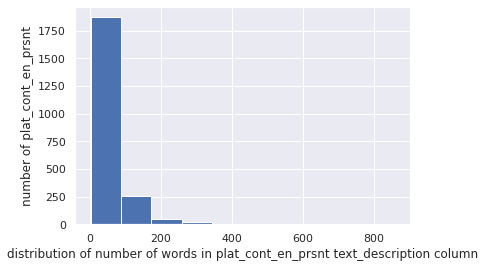

In [ ]:

plt.hist(number_of_text_description)
plt.xlabel('distribution of number of words in plat_cont_en_prsnt text_description column')
plt.ylabel('number of plat_cont_en_prsnt')
plt.show()

Selected DF

In [ ]:
plat_cont_en_prsnt = plat_cont_en_prsnt[['title', 'text_description']]

In [ ]:
plat_cont_en_prsnt.head()

title                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                           

### Create numpy array from text_description column

In [ ]:
text_description_array = plat_cont_en_prsnt['text_description'].to_numpy()

In [ ]:
text_description_array

array(['All of this work is still very early. The first full public version of the Ethereum software was recently released, and the system could face some of the same technical and legal problems that have tarnished Bitcoin. Many Bitcoin advocates say Ethereum will face more security problems than Bitcoin because of the greater complexity of the software. Thus far, Ethereum has faced much less testing, and many fewer attacks, than Bitcoin. The novel design of Ethereum may also invite intense scrutiny by authorities given that potentially fraudulent contracts, like the Ponzi schemes, can be written directly into the Ethereum system. But the sophisticated capabilities of the system have made it fascinating to some executives in corporate America. IBM said last year that it was experimenting with Ethereum as a way to control real world objects in the so-called Internet of things. Microsoft has been working on several projects that make it easier to use Ethereum on its computing cloud, Azu

In [ ]:
text_description_array[0]

'All of this work is still very early. The first full public version of the Ethereum software was recently released, and the system could face some of the same technical and legal problems that have tarnished Bitcoin. Many Bitcoin advocates say Ethereum will face more security problems than Bitcoin because of the greater complexity of the software. Thus far, Ethereum has faced much less testing, and many fewer attacks, than Bitcoin. The novel design of Ethereum may also invite intense scrutiny by authorities given that potentially fraudulent contracts, like the Ponzi schemes, can be written directly into the Ethereum system. But the sophisticated capabilities of the system have made it fascinating to some executives in corporate America. IBM said last year that it was experimenting with Ethereum as a way to control real world objects in the so-called Internet of things. Microsoft has been working on several projects that make it easier to use Ethereum on its computing cloud, Azure. "Et

In [ ]:
type(text_description_array[0])

str

### Generate Words from text_description Array by Splitting

In [ ]:
words_list = []
for keyword in text_description_array:
    splitted_words = keyword.lower().split(',')
    words_list.append(splitted_words)
    

In [ ]:
words_list

[['all of this work is still very early. the first full public version of the ethereum software was recently released',
  ' and the system could face some of the same technical and legal problems that have tarnished bitcoin. many bitcoin advocates say ethereum will face more security problems than bitcoin because of the greater complexity of the software. thus far',
  ' ethereum has faced much less testing',
  ' and many fewer attacks',
  ' than bitcoin. the novel design of ethereum may also invite intense scrutiny by authorities given that potentially fraudulent contracts',
  ' like the ponzi schemes',
  ' can be written directly into the ethereum system. but the sophisticated capabilities of the system have made it fascinating to some executives in corporate america. ibm said last year that it was experimenting with ethereum as a way to control real world objects in the so-called internet of things. microsoft has been working on several projects that make it easier to use ethereum on

In [ ]:
words_list[7]

['bitcoin.com spoke with the openledger ceo',
 ' ronny boesing to get deeper insight of how decentralized conglomerates will challenge the status quo',
 ' why they will bring greater financial freedom to the public',
 " and the disadvantages of bitcoin when it comes to enterprise scaling compared to dc's. also read: deloitte: blockchain will 'gain significant traction' by 2020 the coming age of 'decentralized conglomerates' as the openledger team recently its global enterprise 3.0 program",
 ' its universal shared application called "decentralized conglomerate" (dc) is poised to revolutionize how we look at big business in the 21st century. for a long time',
 ' the traditional conglomerate model went unchallenged (e.g. berkshire hathaway',
 ' philip morris etc.) until the emergence of the internet and increasing global interconnectivity. a new digital conglomerate structure began to emerge with the likes of google (and its alphabet inc. parent company)',
 ' which became more efficient 

In [ ]:
len(words_list), len(words_list[0]), len(words_list[1])

(2211, 62, 14)

## Create Dictionary

Install Gensim

In [ ]:
! pip install gensim

In [ ]:
from gensim.corpora.dictionary import Dictionary

create a dictionary of words from words list

In [ ]:
dictionary = Dictionary(words_list) 

In [ ]:
dictionary

In [ ]:
len(dictionary)

105897

#### Total number of words in the words_list

In [ ]:
number_words = 0
for word in words_list:
    number_words = number_words + len(word)

In [ ]:
number_words

114511

In [ ]:
dictionary.get(0), dictionary.get(1), dictionary.get(100)

(' "blockchain: tapping i nto the real potential ',
 " 'it's still an experiment",
 ' and that is not the ibm of my experience')

In [ ]:
dictionary.get(1000)

" and was named the #7 best app by apple that same year. it's also a #4 travel app in the u.s. on the app store"

## Generate Bag of Words

In [ ]:
words_list[0]

['all of this work is still very early. the first full public version of the ethereum software was recently released',
 ' and the system could face some of the same technical and legal problems that have tarnished bitcoin. many bitcoin advocates say ethereum will face more security problems than bitcoin because of the greater complexity of the software. thus far',
 ' ethereum has faced much less testing',
 ' and many fewer attacks',
 ' than bitcoin. the novel design of ethereum may also invite intense scrutiny by authorities given that potentially fraudulent contracts',
 ' like the ponzi schemes',
 ' can be written directly into the ethereum system. but the sophisticated capabilities of the system have made it fascinating to some executives in corporate america. ibm said last year that it was experimenting with ethereum as a way to control real world objects in the so-called internet of things. microsoft has been working on several projects that make it easier to use ethereum on its co

doc2bow = Document to BOW[Bag of word]

In [ ]:
bow = dictionary.doc2bow(words_list[0])

In [ ]:
bow

[(0, 1),
 (1, 1),
 (2, 1),
 (3, 1),
 (4, 1),
 (5, 1),
 (6, 1),
 (7, 1),
 (8, 1),
 (9, 1),
 (10, 1),
 (11, 1),
 (12, 1),
 (13, 1),
 (14, 1),
 (15, 1),
 (16, 1),
 (17, 1),
 (18, 1),
 (19, 1),
 (20, 1),
 (21, 1),
 (22, 1),
 (23, 1),
 (24, 2),
 (25, 1),
 (26, 1),
 (27, 1),
 (28, 1),
 (29, 1),
 (30, 1),
 (31, 1),
 (32, 1),
 (33, 1),
 (34, 1),
 (35, 1),
 (36, 1),
 (37, 1),
 (38, 1),
 (39, 1),
 (40, 1),
 (41, 1),
 (42, 1),
 (43, 1),
 (44, 1),
 (45, 1),
 (46, 1),
 (47, 1),
 (48, 1),
 (49, 1),
 (50, 1),
 (51, 1),
 (52, 1),
 (53, 1),
 (54, 1),
 (55, 1),
 (56, 1),
 (57, 1),
 (58, 1),
 (59, 1),
 (60, 1)]

In [ ]:
len(words_list[0]), len(bow)

(62, 61)

### Generate Corpus by creating BOW of each document

In [ ]:

corpus = [dictionary.doc2bow(doc) for doc in words_list] 


In [ ]:
print(corpus)

[[(0, 1), (1, 1), (2, 1), (3, 1), (4, 1), (5, 1), (6, 1), (7, 1), (8, 1), (9, 1), (10, 1), (11, 1), (12, 1), (13, 1), (14, 1), (15, 1), (16, 1), (17, 1), (18, 1), (19, 1), (20, 1), (21, 1), (22, 1), (23, 1), (24, 2), (25, 1), (26, 1), (27, 1), (28, 1), (29, 1), (30, 1), (31, 1), (32, 1), (33, 1), (34, 1), (35, 1), (36, 1), (37, 1), (38, 1), (39, 1), (40, 1), (41, 1), (42, 1), (43, 1), (44, 1), (45, 1), (46, 1), (47, 1), (48, 1), (49, 1), (50, 1), (51, 1), (52, 1), (53, 1), (54, 1), (55, 1), (56, 1), (57, 1), (58, 1), (59, 1), (60, 1)], [(61, 1), (62, 1), (63, 1), (64, 1), (65, 1), (66, 1), (67, 1), (68, 1), (69, 1), (70, 1), (71, 1), (72, 1), (73, 1), (74, 1)], [(75, 1), (76, 1), (77, 1), (78, 1), (79, 1), (80, 1), (81, 1), (82, 1), (83, 1), (84, 1), (85, 1), (86, 1), (87, 1)], [(24, 1), (88, 1), (89, 1), (90, 1), (91, 1), (92, 1), (93, 1), (94, 1), (95, 1), (96, 1), (97, 1), (98, 1), (99, 1), (100, 1), (101, 1), (102, 1), (103, 1), (104, 1), (105, 1), (106, 1), (107, 1), (108, 1), (10

In [ ]:
len(corpus), len(corpus[0]), len(corpus[1])

(2211, 61, 14)

In [ ]:
len(words_list), len(words_list[0])

(2211, 62)

### TF-IDF Model

TF = Term frequency -> count/no.

IDF = Inverse doc freq. -> log(N/n)

In [ ]:

from gensim.models.tfidfmodel import TfidfModel


create tfidf model of the corpus

In [ ]:

tfidf = TfidfModel(corpus)

In [ ]:
tfidf

In [ ]:
tfidf[corpus[0]]

[(0, 0.12909966821260782),
 (1, 0.12909966821260782),
 (2, 0.12909966821260782),
 (3, 0.12909966821260782),
 (4, 0.12909966821260782),
 (5, 0.12909966821260782),
 (6, 0.12909966821260782),
 (7, 0.12909966821260782),
 (8, 0.12909966821260782),
 (9, 0.12909966821260782),
 (10, 0.12909966821260782),
 (11, 0.12909966821260782),
 (12, 0.12909966821260782),
 (13, 0.12909966821260782),
 (14, 0.12909966821260782),
 (15, 0.12909966821260782),
 (16, 0.12909966821260782),
 (17, 0.12909966821260782),
 (18, 0.12909966821260782),
 (19, 0.12909966821260782),
 (20, 0.12909966821260782),
 (21, 0.12909966821260782),
 (22, 0.12909966821260782),
 (23, 0.12909966821260782),
 (24, 0.11773213016678309),
 (25, 0.12909966821260782),
 (26, 0.12909966821260782),
 (27, 0.12909966821260782),
 (28, 0.12909966821260782),
 (29, 0.12909966821260782),
 (30, 0.12909966821260782),
 (31, 0.12909966821260782),
 (32, 0.12909966821260782),
 (33, 0.12909966821260782),
 (34, 0.12909966821260782),
 (35, 0.12909966821260782),
 (

## Generate Similarity Matrix

In [ ]:
from gensim.similarities import MatrixSimilarity


In [ ]:
sims = MatrixSimilarity(tfidf[corpus], num_features=len(dictionary))


In [ ]:
print(sims)

MatrixSimilarity<2211 docs, 105897 features>


In [ ]:
sims[corpus[0]]

array([0.9881603, 0.       , 0.       , ..., 0.       , 0.       ,
       0.       ], dtype=float32)

In [ ]:
len(sims[corpus[0]])

2211

## Generate Recommendation for a news

In [ ]:
news_title = "IEEE to Talk Blockchain at Cloud Computing Oxford-Con - CoinDesk"

#### n = no of recommendations

In [ ]:
n = 5

#### Get the news row

In [ ]:
news = plat_cont_en_prsnt.loc[plat_cont_en_prsnt.title==news_title] 

In [ ]:
news

,title,text_description
5,IEEE to Talk Blockchain at Cloud Computing Oxford-Con - CoinDesk,"One of the largest and oldest organizations for computing professionals will kick off its annual conference on the future of mobile cloud computing tomorrow, where blockchain is scheduled to be one of the attractions. With more than 421,000 members in 260 countries, the Institute of Electrical and Electronics Engineers (IEEE) holding such a high-profile event has the potential to accelerate the rate of blockchain adoption by the engineering community. At the four-day conference, beginning Tuesday, the IEEE will host five blockchain seminars at the 702-year-old Exeter College of Oxford. The conference, IEEE Mobile Cloud 2016, is the organization's fourth annual event dedicated to mobile cloud computing services and engineering. Speaking at the event, hosted at Oxford University, professor Wei-Tek Tsai of the School of Computing, Informatics and Decision Systems engineering at Arizona State University will talk about the future of blockchain technology as an academic topic of research. Computing shift While this looks to be the first IEEE conference to deal so closely with blockchain, its presence at an event dedicated to cloud computing is no surprise. 2016 is shaping up to be the year many stopped talking about bitcoin as a decentralized ledger and started talking about it as a database. Last month, IBM made a huge splash in the blockchain ecosystem when it announced among a wide range of other news, that it would be offering a wide range of blockchain-related initiatives. Further, in November, Microsoft coined the term Blockchain-as-a-Service (BaaS) to describe its sandbox environment where developers could experiment with tools hosted on the company's Azure Cloud platform. Companies including ConsenSys, Augur, BitShares and Slock.it have joined that effort. Oxford University via Shutterstock"


#### Generate words_list by splitting the text_description column

In [ ]:
words_list = news['text_description'].iloc[0].split(',')

In [ ]:
words_list

['One of the largest and oldest organizations for computing professionals will kick off its annual conference on the future of mobile cloud computing tomorrow',
 ' where blockchain is scheduled to be one of the attractions. With more than 421',
 '000 members in 260 countries',
 ' the Institute of Electrical and Electronics Engineers (IEEE) holding such a high-profile event has the potential to accelerate the rate of blockchain adoption by the engineering community. At the four-day conference',
 ' beginning Tuesday',
 ' the IEEE will host five blockchain seminars at the 702-year-old Exeter College of Oxford. The conference',
 ' IEEE Mobile Cloud 2016',
 " is the organization's fourth annual event dedicated to mobile cloud computing services and engineering. Speaking at the event",
 ' hosted at Oxford University',
 ' professor Wei-Tek Tsai of the School of Computing',
 ' Informatics and Decision Systems engineering at Arizona State University will talk about the future of blockchain tech

#### set the query_doc to the words_list

In [ ]:
query_doc = words_list 

In [ ]:
query_doc

['One of the largest and oldest organizations for computing professionals will kick off its annual conference on the future of mobile cloud computing tomorrow',
 ' where blockchain is scheduled to be one of the attractions. With more than 421',
 '000 members in 260 countries',
 ' the Institute of Electrical and Electronics Engineers (IEEE) holding such a high-profile event has the potential to accelerate the rate of blockchain adoption by the engineering community. At the four-day conference',
 ' beginning Tuesday',
 ' the IEEE will host five blockchain seminars at the 702-year-old Exeter College of Oxford. The conference',
 ' IEEE Mobile Cloud 2016',
 " is the organization's fourth annual event dedicated to mobile cloud computing services and engineering. Speaking at the event",
 ' hosted at Oxford University',
 ' professor Wei-Tek Tsai of the School of Computing',
 ' Informatics and Decision Systems engineering at Arizona State University will talk about the future of blockchain tech

#### get bag of words from the query_doc

In [ ]:
query_doc_bow = dictionary.doc2bow(query_doc) 

In [ ]:
query_doc_bow

[(209, 1)]

In [ ]:
len(query_doc_bow), len(query_doc)

(1, 18)

### Generate TF-IDF values for the query_doc_bow

In [ ]:
query_doc_tfidf = tfidf[query_doc_bow] 

In [ ]:
query_doc_tfidf

[(209, 1.0)]

### Get Similarity Score using Similarity Matrix

In [ ]:
similarity_array = sims[query_doc_tfidf] 

In [ ]:
similarity_array

array([0., 0., 0., ..., 0., 0., 0.], dtype=float32)

In [ ]:
len(similarity_array)

2211

### Create a Series to Visualize Similarity Score along with news Names

In [ ]:
similarity_series = pd.Series(similarity_array.tolist(), index=plat_cont_en_prsnt.title.values)

In [ ]:
similarity_series

Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's        0.000000
Bitcoin Future: When GBPcoin of Branson Wins Over USDcoin of Trump             0.000000
Google Data Center 360° Tour                                                   0.000000
IBM Wants to "Evolve the Internet" With Blockchain Technology                  0.000000
IEEE to Talk Blockchain at Cloud Computing Oxford-Con - CoinDesk               0.235702
                                                                                 ...   
Swift Top 10 Articles For The Past Year (v.2017)                               0.000000
Amazon takes on Skype and GoToMeeting with its Chime video conferencing app    0.000000
Code.org 2016 Annual Report                                                    0.000000
JPMorgan Software Does in Seconds What Took Lawyers 360,000 Hours              0.000000
The 2017 Acquia Partners of the Year                                           0.000000
Length: 2211, dtype: float64

### Sort the series to get Top Recommended plat_cont_en_prsnt

In [ ]:

recommended_plat_cont_en_prsnt = similarity_series.sort_values(ascending=False)[1:n+1] 



In [ ]:
recommended_plat_cont_en_prsnt

The 2017 Acquia Partners of the Year                                          0.0
Google releases keyboard for the iPhone with built-in search features         0.0
Strategyzer | Business Model Generation - Book                                0.0
Quip now connects with Slack to help teams kick more butt across the globe    0.0
It's coming! The Internet of Eyes will allow objects to see                   0.0
dtype: float64

## Get highest TF-IDF values words for this news which influenced the Recommendations

In [ ]:
news

,title,text_description
5,IEEE to Talk Blockchain at Cloud Computing Oxford-Con - CoinDesk,"One of the largest and oldest organizations for computing professionals will kick off its annual conference on the future of mobile cloud computing tomorrow, where blockchain is scheduled to be one of the attractions. With more than 421,000 members in 260 countries, the Institute of Electrical and Electronics Engineers (IEEE) holding such a high-profile event has the potential to accelerate the rate of blockchain adoption by the engineering community. At the four-day conference, beginning Tuesday, the IEEE will host five blockchain seminars at the 702-year-old Exeter College of Oxford. The conference, IEEE Mobile Cloud 2016, is the organization's fourth annual event dedicated to mobile cloud computing services and engineering. Speaking at the event, hosted at Oxford University, professor Wei-Tek Tsai of the School of Computing, Informatics and Decision Systems engineering at Arizona State University will talk about the future of blockchain technology as an academic topic of research. Computing shift While this looks to be the first IEEE conference to deal so closely with blockchain, its presence at an event dedicated to cloud computing is no surprise. 2016 is shaping up to be the year many stopped talking about bitcoin as a decentralized ledger and started talking about it as a database. Last month, IBM made a huge splash in the blockchain ecosystem when it announced among a wide range of other news, that it would be offering a wide range of blockchain-related initiatives. Further, in November, Microsoft coined the term Blockchain-as-a-Service (BaaS) to describe its sandbox environment where developers could experiment with tools hosted on the company's Azure Cloud platform. Companies including ConsenSys, Augur, BitShares and Slock.it have joined that effort. Oxford University via Shutterstock"


### Corpus for 16th index

In [ ]:
corpus[16]

[(796, 1),
 (797, 1),
 (798, 1),
 (799, 1),
 (800, 1),
 (801, 1),
 (802, 1),
 (803, 1),
 (804, 1),
 (805, 1),
 (806, 1),
 (807, 1),
 (808, 1),
 (809, 1),
 (810, 1),
 (811, 1),
 (812, 1),
 (813, 1),
 (814, 1),
 (815, 1),
 (816, 1),
 (817, 1),
 (818, 1),
 (819, 1),
 (820, 1)]

In [ ]:
corpus[news.index.values.tolist()[0]]

[(211, 1),
 (212, 1),
 (213, 1),
 (214, 1),
 (215, 1),
 (216, 1),
 (217, 1),
 (218, 1),
 (219, 1),
 (220, 1),
 (221, 1),
 (222, 1),
 (223, 1),
 (224, 1),
 (225, 1),
 (226, 1),
 (227, 1),
 (228, 1),
 (229, 1),
 (230, 1),
 (231, 1),
 (232, 1),
 (233, 1),
 (234, 1),
 (235, 1),
 (236, 2),
 (237, 1),
 (238, 1),
 (239, 1),
 (240, 1),
 (241, 1),
 (242, 1)]

### TF-IDF Values

In [ ]:
tfidf[corpus[news.index.values.tolist()[0]]]

[(211, 0.16967431015415807),
 (212, 0.16967431015415807),
 (213, 0.16967431015415807),
 (214, 0.16967431015415807),
 (215, 0.16967431015415807),
 (216, 0.16967431015415807),
 (217, 0.16967431015415807),
 (218, 0.16967431015415807),
 (219, 0.16967431015415807),
 (220, 0.16967431015415807),
 (221, 0.16967431015415807),
 (222, 0.16967431015415807),
 (223, 0.16967431015415807),
 (224, 0.16967431015415807),
 (225, 0.14546947482602512),
 (226, 0.16967431015415807),
 (227, 0.16967431015415807),
 (228, 0.16967431015415807),
 (229, 0.16967431015415807),
 (230, 0.16967431015415807),
 (231, 0.16967431015415807),
 (232, 0.16967431015415807),
 (233, 0.16967431015415807),
 (234, 0.16967431015415807),
 (235, 0.16967431015415807),
 (236, 0.33934862030831614),
 (237, 0.16967431015415807),
 (238, 0.16967431015415807),
 (239, 0.16967431015415807),
 (240, 0.16967431015415807),
 (241, 0.16967431015415807),
 (242, 0.16967431015415807)]

### Sorted TF-IDF values

In [ ]:

sorted_tfidf_weights = sorted(tfidf[corpus[news.index.values.tolist()[0]]], key=lambda w: w[1], reverse=True)


In [ ]:
sorted_tfidf_weights

[(236, 0.33934862030831614),
 (211, 0.16967431015415807),
 (212, 0.16967431015415807),
 (213, 0.16967431015415807),
 (214, 0.16967431015415807),
 (215, 0.16967431015415807),
 (216, 0.16967431015415807),
 (217, 0.16967431015415807),
 (218, 0.16967431015415807),
 (219, 0.16967431015415807),
 (220, 0.16967431015415807),
 (221, 0.16967431015415807),
 (222, 0.16967431015415807),
 (223, 0.16967431015415807),
 (224, 0.16967431015415807),
 (226, 0.16967431015415807),
 (227, 0.16967431015415807),
 (228, 0.16967431015415807),
 (229, 0.16967431015415807),
 (230, 0.16967431015415807),
 (231, 0.16967431015415807),
 (232, 0.16967431015415807),
 (233, 0.16967431015415807),
 (234, 0.16967431015415807),
 (235, 0.16967431015415807),
 (237, 0.16967431015415807),
 (238, 0.16967431015415807),
 (239, 0.16967431015415807),
 (240, 0.16967431015415807),
 (241, 0.16967431015415807),
 (242, 0.16967431015415807),
 (225, 0.14546947482602512)]

In [ ]:
dictionary.get(3515)

' and mac os x. not only can they be used from the command line to control resources in the cloud platforms'

In [ ]:
dictionary.get(3534)

" and you have total control over the instance while it's running. the second kind of spot instances"

In [ ]:
print('Top words associated with this news by tf-idf are: ')
for term_id, weight in sorted_tfidf_weights[:5]:
    print(" '%s' %.5f" %(dictionary.get(term_id), weight))



Top words associated with this news by tf-idf are: 
 ' though. banks need to innovate at an accelerated pace' 0.33935
 ' a lot of financial experts see and as two major threats to the banking system' 0.16967
 ' allowing for frictionless and real-time transfers of value' 0.16967
 ' although it may involve swallowing some of the pride that are associated with the banking system. fintech companies are' 0.16967
 ' although they might be able to in the long run. any bank that is too slow - or simply unwilling - to innovate will be left behind in the long term' 0.16967


# Creating a Modular code by creating a function for Query news Input

In [ ]:
def news_recommendation(news_title, number_of_hits=5):
    news = plat_cont_en_prsnt.loc[plat_cont_en_prsnt.title==news_title] # get the news row
    text_description = news['text_description'].iloc[0].split(',') #get the text_description as a Series (news['text_description']),
    # get just the text_description string ([0]), and then convert to a list of text_description (.split(',') )
    query_doc = text_description #set the query_doc to the list of text_description
    
    query_doc_bow = dictionary.doc2bow(query_doc) # get a bag of words from the query_doc
    query_doc_tfidf = tfidf[query_doc_bow] #convert the regular bag of words model to a tf-idf model where we have tuples
    # of the news ID and it's tf-idf value for the news

    similarity_array = sims[query_doc_tfidf] # get the array of similarity values between our news and every other news. 
    #So the length is the number of plat_cont_en_prsnt we have. To do this, we pass our list of tf-idf tuples to sims.

    similarity_series = pd.Series(similarity_array.tolist(), index=plat_cont_en_prsnt.title.values) #Convert to a Series
    recommended_plat_cont_en_prsnt = similarity_series.sort_values(ascending=False)[1:number_of_hits+1] 
    #get the top matching results, i.e. most similar plat_cont_en_prsnt; start from index 1 because every news is most similar to itself
    print("Top Recommended plat_cont_en_prsnt along with Similarity Score: ")
    print(recommended_plat_cont_en_prsnt)

In [ ]:
news_recommendation('Google Data Center 360° Tour', 5)

Top Recommended plat_cont_en_prsnt along with Similarity Score: 
The 2017 Acquia Partners of the Year                                          0.0
Google releases keyboard for the iPhone with built-in search features         0.0
Strategyzer | Business Model Generation - Book                                0.0
Quip now connects with Slack to help teams kick more butt across the globe    0.0
It's coming! The Internet of Eyes will allow objects to see                   0.0
dtype: float64


In [ ]:
news_recommendation('Google Data Center 360° Tour', 5)

Top Recommended plat_cont_en_prsnt along with Similarity Score: 
The 2017 Acquia Partners of the Year                                          0.0
Google releases keyboard for the iPhone with built-in search features         0.0
Strategyzer | Business Model Generation - Book                                0.0
Quip now connects with Slack to help teams kick more butt across the globe    0.0
It's coming! The Internet of Eyes will allow objects to see                   0.0
dtype: float64


In [ ]:
news_recommendation('Google Data Center 360° Tour', 5)

Top Recommended plat_cont_en_prsnt along with Similarity Score: 
The 2017 Acquia Partners of the Year                                          0.0
Google releases keyboard for the iPhone with built-in search features         0.0
Strategyzer | Business Model Generation - Book                                0.0
Quip now connects with Slack to help teams kick more butt across the globe    0.0
It's coming! The Internet of Eyes will allow objects to see                   0.0
dtype: float64


## ALS 

### Create Sparse User-Item Matrix

In [ ]:
consumer_rating_cpy = consumer_rating.copy()

In [ ]:
consumer_rating_cpy.shape

(40710, 5)

In [ ]:
consumer_rating_cpy.head()
print(consumer_rating_cpy)

               consumer_id              item_id  ...  consumer_code  item_code
0     -9223121837663643404 -8949113594875411859  ...              0         65
1     -9223121837663643404 -8377626164558006982  ...              0        160
2     -9223121837663643404 -8208801367848627943  ...              0        188
3     -9223121837663643404 -8187220755213888616  ...              0        196
4     -9223121837663643404 -7423191370472335463  ...              0        314
...                    ...                  ...  ...            ...        ...
40705  9210530975708218054  8477804012624580461  ...           1894       2861
40706  9210530975708218054  8526042588044002101  ...           1894       2867
40707  9210530975708218054  8856169137131817223  ...           1894       2922
40708  9210530975708218054  8869347744613364434  ...           1894       2925
40709  9210530975708218054  9209886322932807692  ...           1894       2981

[40710 rows x 5 columns]


In [ ]:
consumer_rating_cpy.drop(["consumer_id", "item_id"], axis =1)

,interaction_type,consumer_code,item_code
0,1.0,0,65
1,1.0,0,160
2,1.0,0,188
3,1.0,0,196
4,1.0,0,314
...,...,...,...
40705,3.0,1894,2861
40706,1.0,1894,2867
40707,1.0,1894,2922
40708,1.0,1894,2925


In [ ]:
consumer_rating_cpy.describe()

,interaction_type,consumer_code,item_code
count,40710.000000,40710.000000,40710.000000
mean,1.180128,940.034267,1480.558683
std,0.445627,523.672408,861.206218
min,1.000000,0.000000,0.000000
25%,1.000000,550.000000,732.000000
50%,1.000000,927.000000,1481.000000
75%,1.000000,1344.000000,2205.000000
max,4.000000,1894.000000,2986.000000


In [ ]:
from scipy.sparse import csr_matrix

In [ ]:
alpha = 40

In [ ]:
consumer_rating_cpy.shape[0]

40710

In [ ]:
#sparse_user_item = csr_matrix( ([alpha]*consumer_rating_cpy.shape[0], (consumer_rating_cpy['consumer_code'], consumer_rating_cpy['item_code']) ))
sparse_user_item = csr_matrix( (consumer_rating_cpy['interaction_type'].astype(float), (consumer_rating_cpy['consumer_code'], consumer_rating_cpy['item_code']) ))

In [ ]:
print(sparse_user_item)

  (0, 65)	1.0
  (0, 160)	1.0
  (0, 188)	1.0
  (0, 196)	1.0
  (0, 314)	1.0
  (0, 328)	1.0
  (0, 386)	1.0
  (0, 417)	1.0
  (0, 443)	1.0
  (0, 451)	1.0
  (0, 453)	1.0
  (0, 465)	1.0
  (0, 570)	1.0
  (0, 702)	1.0
  (0, 769)	1.0
  (0, 813)	1.0
  (0, 819)	1.0
  (0, 864)	1.0
  (0, 890)	1.0
  (0, 1087)	1.0
  (0, 1358)	1.0
  (0, 1390)	1.0
  (0, 1411)	1.0
  (0, 1618)	1.0
  (0, 1632)	1.0
  :	:
  (1894, 1977)	3.0
  (1894, 2023)	1.0
  (1894, 2027)	1.0
  (1894, 2071)	1.0
  (1894, 2080)	1.0
  (1894, 2190)	1.0
  (1894, 2253)	1.0
  (1894, 2334)	1.0
  (1894, 2349)	1.0
  (1894, 2451)	1.0
  (1894, 2470)	1.0
  (1894, 2538)	2.0
  (1894, 2608)	1.0
  (1894, 2676)	2.0
  (1894, 2696)	3.0
  (1894, 2719)	1.0
  (1894, 2772)	1.0
  (1894, 2809)	1.0
  (1894, 2814)	2.0
  (1894, 2845)	1.0
  (1894, 2861)	3.0
  (1894, 2867)	1.0
  (1894, 2922)	1.0
  (1894, 2925)	1.0
  (1894, 2981)	1.0


### shape : 1895x2987.  since Total No of consumers  = 1895, No of News = 2987

### Convert to Array

In [ ]:
csr_user_array = sparse_user_item.toarray()

In [ ]:
csr_user_array

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 2., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
len(csr_user_array), len(csr_user_array[0]), csr_user_array[1][1]

(1895, 2987, 0.0)

In [ ]:
max(csr_user_array[1])

2.0

### csr matrix only stores where value is 40 [non-zero]. (Compressed Sparse Row)

In [ ]:
print(sparse_user_item)

  (0, 65)	1.0
  (0, 160)	1.0
  (0, 188)	1.0
  (0, 196)	1.0
  (0, 314)	1.0
  (0, 328)	1.0
  (0, 386)	1.0
  (0, 417)	1.0
  (0, 443)	1.0
  (0, 451)	1.0
  (0, 453)	1.0
  (0, 465)	1.0
  (0, 570)	1.0
  (0, 702)	1.0
  (0, 769)	1.0
  (0, 813)	1.0
  (0, 819)	1.0
  (0, 864)	1.0
  (0, 890)	1.0
  (0, 1087)	1.0
  (0, 1358)	1.0
  (0, 1390)	1.0
  (0, 1411)	1.0
  (0, 1618)	1.0
  (0, 1632)	1.0
  :	:
  (1894, 1977)	3.0
  (1894, 2023)	1.0
  (1894, 2027)	1.0
  (1894, 2071)	1.0
  (1894, 2080)	1.0
  (1894, 2190)	1.0
  (1894, 2253)	1.0
  (1894, 2334)	1.0
  (1894, 2349)	1.0
  (1894, 2451)	1.0
  (1894, 2470)	1.0
  (1894, 2538)	2.0
  (1894, 2608)	1.0
  (1894, 2676)	2.0
  (1894, 2696)	3.0
  (1894, 2719)	1.0
  (1894, 2772)	1.0
  (1894, 2809)	1.0
  (1894, 2814)	2.0
  (1894, 2845)	1.0
  (1894, 2861)	3.0
  (1894, 2867)	1.0
  (1894, 2922)	1.0
  (1894, 2925)	1.0
  (1894, 2981)	1.0


### Create item-user sparse matrix

In [ ]:
sparse_item_user = sparse_user_item.T.tocsr()

In [ ]:
print(sparse_item_user)

  (0, 226)	2.0
  (0, 333)	2.0
  (0, 831)	2.0
  (0, 1142)	2.0
  (0, 1867)	1.0
  (1, 2)	2.0
  (1, 130)	1.0
  (1, 210)	1.0
  (1, 555)	1.0
  (1, 941)	1.0
  (1, 946)	1.0
  (1, 1149)	1.0
  (1, 1235)	3.0
  (1, 1499)	1.0
  (1, 1532)	1.0
  (2, 40)	1.0
  (2, 159)	1.0
  (2, 197)	1.0
  (2, 334)	1.0
  (2, 630)	1.0
  (2, 651)	1.0
  (2, 820)	3.0
  (2, 906)	1.0
  (2, 935)	1.0
  (2, 1004)	1.0
  :	:
  (2985, 798)	1.0
  (2985, 908)	1.0
  (2985, 978)	1.0
  (2985, 1079)	1.0
  (2985, 1136)	1.0
  (2985, 1221)	1.0
  (2985, 1248)	1.0
  (2985, 1263)	1.0
  (2985, 1319)	1.0
  (2985, 1334)	1.0
  (2985, 1343)	1.0
  (2985, 1383)	2.0
  (2985, 1404)	1.0
  (2985, 1405)	1.0
  (2985, 1527)	1.0
  (2985, 1597)	1.0
  (2985, 1728)	1.0
  (2985, 1833)	1.0
  (2985, 1874)	1.0
  (2985, 1888)	1.0
  (2986, 170)	1.0
  (2986, 588)	1.0
  (2986, 1004)	1.0
  (2986, 1237)	1.0
  (2986, 1597)	1.0




```
# This is formatted as code
```

### shape : 2987x1895.  since Total No of News  = 2987 & No of users = 1895

In [ ]:
csr_item_array = sparse_item_user.toarray()

In [ ]:
csr_item_array

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 2., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
len(csr_item_array), len(csr_item_array[0]), csr_item_array[1][2]

(2987, 1895, 2.0)

In [ ]:
print(sparse_item_user)

  (0, 226)	2.0
  (0, 333)	2.0
  (0, 831)	2.0
  (0, 1142)	2.0
  (0, 1867)	1.0
  (1, 2)	2.0
  (1, 130)	1.0
  (1, 210)	1.0
  (1, 555)	1.0
  (1, 941)	1.0
  (1, 946)	1.0
  (1, 1149)	1.0
  (1, 1235)	3.0
  (1, 1499)	1.0
  (1, 1532)	1.0
  (2, 40)	1.0
  (2, 159)	1.0
  (2, 197)	1.0
  (2, 334)	1.0
  (2, 630)	1.0
  (2, 651)	1.0
  (2, 820)	3.0
  (2, 906)	1.0
  (2, 935)	1.0
  (2, 1004)	1.0
  :	:
  (2985, 798)	1.0
  (2985, 908)	1.0
  (2985, 978)	1.0
  (2985, 1079)	1.0
  (2985, 1136)	1.0
  (2985, 1221)	1.0
  (2985, 1248)	1.0
  (2985, 1263)	1.0
  (2985, 1319)	1.0
  (2985, 1334)	1.0
  (2985, 1343)	1.0
  (2985, 1383)	2.0
  (2985, 1404)	1.0
  (2985, 1405)	1.0
  (2985, 1527)	1.0
  (2985, 1597)	1.0
  (2985, 1728)	1.0
  (2985, 1833)	1.0
  (2985, 1874)	1.0
  (2985, 1888)	1.0
  (2986, 170)	1.0
  (2986, 588)	1.0
  (2986, 1004)	1.0
  (2986, 1237)	1.0
  (2986, 1597)	1.0


## Create train, test data

In [ ]:

!pip install implicit

In [ ]:
from implicit.evaluation import train_test_split

In [ ]:
train, test = train_test_split(sparse_item_user, train_percentage=0.8)

In [ ]:
print(train)

  (0, 226)	2.0
  (0, 831)	2.0
  (0, 1867)	1.0
  (1, 2)	2.0
  (1, 130)	1.0
  (1, 210)	1.0
  (1, 555)	1.0
  (1, 941)	1.0
  (1, 946)	1.0
  (1, 1149)	1.0
  (1, 1235)	3.0
  (1, 1499)	1.0
  (1, 1532)	1.0
  (2, 40)	1.0
  (2, 159)	1.0
  (2, 197)	1.0
  (2, 334)	1.0
  (2, 630)	1.0
  (2, 651)	1.0
  (2, 906)	1.0
  (2, 1004)	1.0
  (2, 1182)	1.0
  (2, 1246)	2.0
  (2, 1479)	1.0
  (2, 1529)	1.0
  :	:
  (2985, 236)	1.0
  (2985, 303)	1.0
  (2985, 306)	1.0
  (2985, 400)	1.0
  (2985, 787)	1.0
  (2985, 798)	1.0
  (2985, 908)	1.0
  (2985, 978)	1.0
  (2985, 1079)	1.0
  (2985, 1221)	1.0
  (2985, 1248)	1.0
  (2985, 1263)	1.0
  (2985, 1334)	1.0
  (2985, 1343)	1.0
  (2985, 1383)	2.0
  (2985, 1404)	1.0
  (2985, 1527)	1.0
  (2985, 1597)	1.0
  (2985, 1728)	1.0
  (2985, 1874)	1.0
  (2985, 1888)	1.0
  (2986, 170)	1.0
  (2986, 588)	1.0
  (2986, 1237)	1.0
  (2986, 1597)	1.0


In [ ]:
print(test)

  (0, 333)	2.0
  (0, 1142)	2.0
  (2, 820)	3.0
  (2, 935)	1.0
  (2, 1319)	2.0
  (2, 1657)	1.0
  (3, 17)	1.0
  (3, 99)	1.0
  (3, 284)	1.0
  (3, 968)	1.0
  (3, 999)	2.0
  (3, 1020)	1.0
  (3, 1029)	2.0
  (3, 1164)	1.0
  (3, 1247)	1.0
  (3, 1295)	1.0
  (3, 1698)	1.0
  (4, 926)	1.0
  (5, 348)	1.0
  (5, 808)	1.0
  (5, 1063)	1.0
  (5, 1103)	2.0
  (5, 1213)	1.0
  (5, 1232)	1.0
  (5, 1390)	1.0
  :	:
  (2976, 1221)	1.0
  (2976, 1365)	1.0
  (2976, 1526)	1.0
  (2976, 1695)	1.0
  (2976, 1776)	1.0
  (2976, 1890)	2.0
  (2977, 1269)	1.0
  (2979, 1698)	1.0
  (2980, 1142)	1.0
  (2980, 1301)	1.0
  (2981, 513)	1.0
  (2981, 996)	1.0
  (2981, 1390)	1.0
  (2981, 1459)	1.0
  (2981, 1712)	1.0
  (2982, 906)	1.0
  (2982, 1246)	1.0
  (2982, 1292)	1.0
  (2983, 588)	1.0
  (2984, 682)	1.0
  (2985, 1136)	1.0
  (2985, 1319)	1.0
  (2985, 1405)	1.0
  (2985, 1833)	1.0
  (2986, 1004)	1.0


## Building ALS Model

In [ ]:
import implicit

In [ ]:
##! pip install implicit

In [ ]:
#model = implicit.als.AlternatingLeastSquares(factors=100, regularization=0.1, iterations=20, calculate_training_loss=False)
model = implicit.als.AlternatingLeastSquares(factors=50)

In [ ]:
print(model)

### Train the Model

In [ ]:
data_conf = (sparse_item_user * alpha).astype('double')

In [ ]:
print(data_conf)

  (0, 226)	80.0
  (0, 333)	80.0
  (0, 831)	80.0
  (0, 1142)	80.0
  (0, 1867)	40.0
  (1, 2)	80.0
  (1, 130)	40.0
  (1, 210)	40.0
  (1, 555)	40.0
  (1, 941)	40.0
  (1, 946)	40.0
  (1, 1149)	40.0
  (1, 1235)	120.0
  (1, 1499)	40.0
  (1, 1532)	40.0
  (2, 40)	40.0
  (2, 159)	40.0
  (2, 197)	40.0
  (2, 334)	40.0
  (2, 630)	40.0
  (2, 651)	40.0
  (2, 820)	120.0
  (2, 906)	40.0
  (2, 935)	40.0
  (2, 1004)	40.0
  :	:
  (2985, 798)	40.0
  (2985, 908)	40.0
  (2985, 978)	40.0
  (2985, 1079)	40.0
  (2985, 1136)	40.0
  (2985, 1221)	40.0
  (2985, 1248)	40.0
  (2985, 1263)	40.0
  (2985, 1319)	40.0
  (2985, 1334)	40.0
  (2985, 1343)	40.0
  (2985, 1383)	80.0
  (2985, 1404)	40.0
  (2985, 1405)	40.0
  (2985, 1527)	40.0
  (2985, 1597)	40.0
  (2985, 1728)	40.0
  (2985, 1833)	40.0
  (2985, 1874)	40.0
  (2985, 1888)	40.0
  (2986, 170)	40.0
  (2986, 588)	40.0
  (2986, 1004)	40.0
  (2986, 1237)	40.0
  (2986, 1597)	40.0


In [ ]:
#model.fit(train)
model.fit(data_conf)

  0%|          | 0/15 [00:00<?, ?it/s]

In [ ]:
item_factors, user_factors = model.item_factors, model.user_factors

In [ ]:
item_factors.shape

(2987, 50)

In [ ]:
item_factors[0]

Matrix([[0.8237213  0.84856325 0.8281954  0.01659103 0.0869213  0.51034105
  0.67149746 0.18549645 0.0237388  0.19129026 0.13379323 0.95030344
  0.9751435  0.74847335 0.5358624  0.01231918 0.7216639  0.34986442
  0.8342826  0.49780276 0.02891366 0.86549354 0.23792958 0.90956634
  0.69297373 0.4773214  0.58258146 0.22166482 0.03514775 0.49542326
  0.5838346  0.24326167 0.8027874  0.753236   0.8048217  0.42659268
  0.81605756 0.50210035 0.88201106 0.23318146 0.11869875 0.65424865
  0.04909402 0.1172529  0.50325024 0.00160929 0.31416762 0.5367244
  0.15692241 0.9212067 ]])

In [ ]:
user_factors.shape

(1895, 50)

In [ ]:
user_factors[0]

Matrix([[0.18012816 0.6287748  0.31932533 0.8476079  0.53267425 0.03958409
  0.7279253  0.70483553 0.57917345 0.86852384 0.98635423 0.73604125
  0.15399976 0.42816788 0.34504488 0.80689853 0.5625276  0.36494312
  0.9137192  0.7070155  0.37516835 0.864048   0.83538747 0.66878164
  0.41541487 0.7891012  0.51573795 0.53352445 0.85182977 0.78021413
  0.8695503  0.82268786 0.88081557 0.35000414 0.01148723 0.01620147
  0.04227933 0.6037095  0.20446107 0.41308755 0.18429823 0.803311
  0.08392635 0.2555022  0.35122237 0.26758856 0.7713003  0.31758764
  0.00474029 0.02707425]])

## Generating recommendations for a user_id

In [ ]:
consumer_code = 1
print(sparse_user_item)

  (0, 65)	1.0
  (0, 160)	1.0
  (0, 188)	1.0
  (0, 196)	1.0
  (0, 314)	1.0
  (0, 328)	1.0
  (0, 386)	1.0
  (0, 417)	1.0
  (0, 443)	1.0
  (0, 451)	1.0
  (0, 453)	1.0
  (0, 465)	1.0
  (0, 570)	1.0
  (0, 702)	1.0
  (0, 769)	1.0
  (0, 813)	1.0
  (0, 819)	1.0
  (0, 864)	1.0
  (0, 890)	1.0
  (0, 1087)	1.0
  (0, 1358)	1.0
  (0, 1390)	1.0
  (0, 1411)	1.0
  (0, 1618)	1.0
  (0, 1632)	1.0
  :	:
  (1894, 1977)	3.0
  (1894, 2023)	1.0
  (1894, 2027)	1.0
  (1894, 2071)	1.0
  (1894, 2080)	1.0
  (1894, 2190)	1.0
  (1894, 2253)	1.0
  (1894, 2334)	1.0
  (1894, 2349)	1.0
  (1894, 2451)	1.0
  (1894, 2470)	1.0
  (1894, 2538)	2.0
  (1894, 2608)	1.0
  (1894, 2676)	2.0
  (1894, 2696)	3.0
  (1894, 2719)	1.0
  (1894, 2772)	1.0
  (1894, 2809)	1.0
  (1894, 2814)	2.0
  (1894, 2845)	1.0
  (1894, 2861)	3.0
  (1894, 2867)	1.0
  (1894, 2922)	1.0
  (1894, 2925)	1.0
  (1894, 2981)	1.0


In [ ]:
model.recommend(consumer_code, sparse_user_item)

[(0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0)]

In [ ]:
model.recommend(consumer_code, sparse_user_item, N=20)

[(0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0)]

In [ ]:
output = model.recommend(consumer_code, sparse_user_item)

In [ ]:
output

[(0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0)]

In [ ]:
output_df = pd.DataFrame(output, columns=['item_code', 'als_score'])

In [ ]:
output_df

,item_code,als_score
0,0,0.0
1,0,0.0
2,0,0.0
3,0,0.0
4,0,0.0
5,0,0.0
6,0,0.0
7,0,0.0
8,0,0.0
9,0,0.0


# Load News Data

In [ ]:
news = platform_content[['item_id', 'title']]

In [ ]:
news.head()

,item_id,title
0,-6451309518266745024,"Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's"
1,-4110354420726924665,"Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's"
2,-7292285110016212249,Bitcoin Future: When GBPcoin of Branson Wins Over USDcoin of Trump
3,-6151852268067518688,Google Data Center 360° Tour
4,2448026894306402386,"IBM Wants to ""Evolve the Internet"" With Blockchain Technology"


# Merge recommendation output with news Data

In [ ]:
merged = pd.merge(output_df, consum_item_cd_id, how='left', on='item_code')

In [ ]:
merged

,item_code,als_score,item_id
0,0,0.0,-9222795471790223670
1,0,0.0,-9222795471790223670
2,0,0.0,-9222795471790223670
3,0,0.0,-9222795471790223670
4,0,0.0,-9222795471790223670
5,0,0.0,-9222795471790223670
6,0,0.0,-9222795471790223670
7,0,0.0,-9222795471790223670
8,0,0.0,-9222795471790223670
9,0,0.0,-9222795471790223670


In [ ]:
consum_item_cd_id

,item_code,item_id
40218,0,-9222795471790223670
3340,1,-9216926795620865886
17353,2,-9194572880052200111
234,3,-9192549002213406534
6770,4,-9190737901804729417
...,...,...
11319,2982,9213260650272029784
26246,2983,9215261273565326920
30695,2984,9217155070834564627
6442,2985,9220445660318725468


## Generating recommendations for news


In [ ]:

item_Code = 11
n_similar = 10

In [ ]:

similar = model.similar_items(item_Code, n_similar)


In [ ]:
similar

[(0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0),
 (0, 0.0)]

In [ ]:
type(similar)

list

In [ ]:
similar[0]

(0, 0.0)

In [ ]:
similar_df = pd.DataFrame(similar, columns=['item_code', 'score'])

In [ ]:
similar_df

,item_code,score
0,0,0.0
1,0,0.0
2,0,0.0
3,0,0.0
4,0,0.0
5,0,0.0
6,0,0.0
7,0,0.0
8,0,0.0
9,0,0.0


In [ ]:
news

,item_id,title
0,-6451309518266745024,"Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's"
1,-4110354420726924665,"Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's"
2,-7292285110016212249,Bitcoin Future: When GBPcoin of Branson Wins Over USDcoin of Trump
3,-6151852268067518688,Google Data Center 360° Tour
4,2448026894306402386,"IBM Wants to ""Evolve the Internet"" With Blockchain Technology"
...,...,...
3117,9213260650272029784,"Conheça a Liga IoT, plataforma de inovação aberta que irá acelerar projetos ligados a Internet das Coisas"
3118,-3295913657316686039,Amazon takes on Skype and GoToMeeting with its Chime video conferencing app
3119,3618271604906293310,Code.org 2016 Annual Report
3120,6607431762270322325,"JPMorgan Software Does in Seconds What Took Lawyers 360,000 Hours"


# Merge recommendation output with news Data

In [ ]:
merged_similar = pd.merge(similar_df, consum_item_cd_id, how='left', on='item_code')

In [ ]:
merged_similar

,item_code,score,item_id
0,0,0.0,-9222795471790223670
1,0,0.0,-9222795471790223670
2,0,0.0,-9222795471790223670
3,0,0.0,-9222795471790223670
4,0,0.0,-9222795471790223670
5,0,0.0,-9222795471790223670
6,0,0.0,-9222795471790223670
7,0,0.0,-9222795471790223670
8,0,0.0,-9222795471790223670
9,0,0.0,-9222795471790223670


In [ ]:
merged_similar = pd.merge(merged_similar, news, how='left', on='item_id')

In [ ]:
#plat_cont_en_prsnt

## Hybrid recommendation system

#### Normalise the scores for content and collaborative filtering and combine them with an appropriate weightage to build a hybrid model.

#### Try out hybrids of different types of models that can help recommend items similar to a particular item. 

#### For example, Content+Item-based collaborative model, ALS+Item-based collaborative model, ALS+Content-based model, etc.

### Hybrid Recommendation System: Combine Collaborative & Content based

In [ ]:
data_matrix = consumer_rating.pivot(
    index='consumer_code',
    columns='item_code',
    values='interaction_type'
).fillna(0)

In [ ]:
data_matrix.head()

item_code,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,2947,2948,2949,2950,2951,2952,2953,2954,2955,2956,2957,2958,2959,2960,2961,2962,2963,2964,2965,2966,2967,2968,2969,2970,2971,2972,2973,2974,2975,2976,2977,2978,2979,2980,2981,2982,2983,2984,2985,2986
consumer_code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
data_matrix.shape

(1895, 2987)

# Pairwise Distance

## news pairwise similarity distance

In [ ]:
data_matrix.T

consumer_code,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,1855,1856,1857,1858,1859,1860,1861,1862,1863,1864,1865,1866,1867,1868,1869,1870,1871,1872,1873,1874,1875,1876,1877,1878,1879,1880,1881,1882,1883,1884,1885,1886,1887,1888,1889,1890,1891,1892,1893,1894
item_code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2982,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2983,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2984,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
data_matrix.T.shape

(2987, 1895)

In [ ]:
from sklearn.metrics.pairwise import pairwise_distances 

In [ ]:

item_similarity = 1- pairwise_distances(data_matrix.T, metric='cosine')


In [ ]:
item_similarity

array([[1.        , 0.        , 0.        , ..., 0.32338083, 0.        ,
        0.        ],
       [0.        , 1.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 1.        , ..., 0.        , 0.06666667,
        0.08164966],
       ...,
       [0.32338083, 0.        , 0.        , ..., 1.        , 0.06085806,
        0.1490712 ],
       [0.        , 0.        , 0.06666667, ..., 0.06085806, 1.        ,
        0.08164966],
       [0.        , 0.        , 0.08164966, ..., 0.1490712 , 0.08164966,
        1.        ]])

In [ ]:
item_similarity.shape

(2987, 2987)

## Get similar recommended news for a item_id

In [ ]:
news_index = 5

In [ ]:
news_prediction = pd.DataFrame(item_similarity)

In [ ]:
news_prediction.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,2947,2948,2949,2950,2951,2952,2953,2954,2955,2956,2957,2958,2959,2960,2961,2962,2963,2964,2965,2966,2967,2968,2969,2970,2971,2972,2973,2974,2975,2976,2977,2978,2979,2980,2981,2982,2983,2984,2985,2986
0,1.000000,0.0,0.000000,0.125245,0.242536,0.000000,0.0,0.323381,0.000000,0.000000,0.000000,0.00000,0.114332,0.00000,0.000000,0.0,0.000000,0.000000,0.147945,0.206835,0.242536,0.00000,0.000000,0.000,0.000000,0.0,0.0,0.000000,0.259281,0.153393,0.239236,0.000000,0.000000,0.000000,0.000000,0.161690,0.333849,0.000000,0.000000,0.151717,...,0.134535,0.00000,0.000000,0.000000,0.151511,0.366679,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.140028,0.000000,0.0,0.33776,0.000000,0.000000,0.000000,0.000000,0.161690,0.000000,0.000000,0.000000,0.292509,0.0,0.0,0.000000,0.363803,0.250490,0.000000,0.650791,0.000000,0.00000,0.000000,0.323381,0.000000,0.00000
1,0.000000,1.0,0.000000,0.000000,0.000000,0.038576,0.0,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.00000,0.104828,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.186097,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.00000
2,0.000000,0.0,1.000000,0.117851,0.000000,0.096825,0.0,0.000000,0.000000,0.000000,0.091287,0.00000,0.086066,0.00000,0.000000,0.0,0.182574,0.048795,0.167054,0.077850,0.182574,0.00000,0.365148,0.000,0.258199,0.0,0.0,0.000000,0.097590,0.000000,0.000000,0.031782,0.079682,0.149071,0.151911,0.030429,0.000000,0.091287,0.141421,0.000000,...,0.101274,0.00000,0.000000,0.163299,0.085540,0.000000,0.0,0.0,0.156556,0.069007,0.0,0.0,0.225924,0.038706,0.000000,0.146385,0.0,0.00000,0.058471,0.069007,0.057735,0.000000,0.000000,0.000000,0.000000,0.000000,0.110096,0.0,0.0,0.252352,0.000000,0.000000,0.000000,0.000000,0.129099,0.34641,0.086066,0.000000,0.066667,0.08165
3,0.125245,0.0,0.117851,1.000000,0.000000,0.091287,0.0,0.129099,0.129099,0.111803,0.193649,0.06455,0.182574,0.06455,0.129099,0.0,0.064550,0.069007,0.118125,0.192669,0.193649,0.06455,0.129099,0.000,0.091287,0.0,0.0,0.129099,0.138013,0.000000,0.106119,0.022473,0.028172,0.105409,0.179029,0.129099,0.000000,0.064550,0.066667,0.053838,...,0.071611,0.11547,0.071611,0.115470,0.221781,0.243975,0.0,0.0,0.132842,0.243975,0.0,0.0,0.114109,0.205268,0.111803,0.034503,0.0,0.00000,0.041345,0.243975,0.081650,0.091287,0.215166,0.071611,0.129099,0.000000,0.272475,0.0,0.0,0.100372,0.000000,0.233333,0.091287,0.115470,0.243432,0.08165,0.060858,0.215166,0.164992,0.00000
4,0.242536,0.0,0.000000,0.000000,1.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.37500,0.000000,0.00000,0.000000,0.0,0.000000,0.000000,0.076249,0.000000,0.250000,0.00000,0.000000,0.125,0.000000,0.0,0.0,0.000000,0.000000,0.158114,0.082199,0.000000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.00000,0.000000,0.223607,0.078087,0.188982,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.133631,0.0,0.00000,0.000000,0.000000,0.000000,0.000000,0.333333,0.138675,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.129099,0.000000,0.223607,0.000000,0.00000,0.000000,0.000000,0.000000,0.00000


In [ ]:
news_prediction.shape

(2987, 2987)

In [ ]:
news_prediction.iloc[news_index]

0       0.000000
1       0.038576
2       0.096825
3       0.091287
4       0.000000
          ...   
2982    0.111803
2983    0.208333
2984    0.000000
2985    0.032275
2986    0.000000
Name: 5, Length: 2987, dtype: float64

In [ ]:
item_recommendation = pd.DataFrame(news_prediction.iloc[news_index].sort_values(ascending=False))

In [ ]:
item_recommendation.head()

,5
5,1.000000
295,0.375000
2512,0.334077
1206,0.323498
900,0.321560


In [ ]:
item_recommendation.reset_index(inplace=True)

In [ ]:
item_recommendation.head()

,index,5
0,5,1.000000
1,295,0.375000
2,2512,0.334077
3,1206,0.323498
4,900,0.321560


In [ ]:
item_recommendation.columns = ['item_code', 'score']

In [ ]:
item_recommendation.head()

,item_code,score
0,5,1.000000
1,295,0.375000
2,2512,0.334077
3,1206,0.323498
4,900,0.321560


In [ ]:
item_recommendation.dtypes

item_code      int64
score        float64
dtype: object

In [ ]:
item_recommendation.describe()

,item_code,score
count,2987.000000,2987.000000
mean,1493.000000,0.060689
std,862.416953,0.068630
min,0.000000,0.000000
25%,746.500000,0.000000
50%,1493.000000,0.045644
75%,2239.500000,0.102062
max,2986.000000,1.000000


In [ ]:
merged = pd.merge(item_recommendation, consum_item_cd_id, on='item_code', how='inner')

In [ ]:
merged


,item_code,score,item_id
0,5,1.000000,-9189659052158407108
1,295,0.375000,-7534240757267992657
2,2512,0.334077,6317717254029043123
3,1206,0.323498,-1634742667970363668
4,900,0.321560,-3700095596785790870
...,...,...,...
2982,1590,0.000000,643905832258297060
2983,1595,0.000000,668505019835540303
2984,1597,0.000000,679005777543560737
2985,1598,0.000000,685073630661800600


In [ ]:
merged

,item_code,score,item_id
0,5,1.000000,-9189659052158407108
1,295,0.375000,-7534240757267992657
2,2512,0.334077,6317717254029043123
3,1206,0.323498,-1634742667970363668
4,900,0.321560,-3700095596785790870
...,...,...,...
2982,1590,0.000000,643905832258297060
2983,1595,0.000000,668505019835540303
2984,1597,0.000000,679005777543560737
2985,1598,0.000000,685073630661800600


In [ ]:
merged = pd.merge(merged, platform_content, on='item_id', how='left')

In [ ]:
merged

item_code  ...  language
0             5  ...        en
1           295  ...        en
2          2512  ...        en
3          1206  ...        en
4           900  ...        en
...         ...  ...       ...
3044       1590  ...        en
3045       1595  ...        en
3046       1597  ...        pt
3047       1598  ...        en
3048          0  ...        pt

[3049 rows x 15 columns]

In [ ]:
merged.shape

(3049, 15)

In [ ]:
collab_output = merged[merged['title'].notna()]

In [ ]:
collab_output.shape

(3049, 15)

In [ ]:
collab_output.head(10)

item_code  ...  language
0          5  ...        en
1        295  ...        en
2       2512  ...        en
3       1206  ...        en
4        900  ...        en
5       2234  ...        en
6        386  ...        en
7       2789  ...        pt
8        759  ...        en
9       2325  ...        en

[10 rows x 15 columns]

In [ ]:
collab_output.describe()

,item_code,score,item_id,event_timestamp,producer_id,producer_session_id
count,3049.000000,3049.000000,3.049000e+03,3.049000e+03,3.049000e+03,3.049000e+03
mean,1495.548049,0.059949,3.478357e+16,1.468907e+09,4.013524e+17,1.717000e+17
std,864.086709,0.068591,5.392507e+18,7.583451e+06,4.345928e+18,5.400549e+18
min,0.000000,0.000000,-9.222795e+18,1.459193e+09,-9.120686e+18,-9.212055e+18
25%,749.000000,0.000000,-4.668566e+18,1.462451e+09,-1.479312e+18,-4.653302e+18
50%,1494.000000,0.044194,3.327102e+16,1.467229e+09,-7.092877e+17,3.120132e+17
75%,2244.000000,0.102062,4.757923e+18,1.473974e+09,3.609194e+18,4.836762e+18
max,2986.000000,1.000000,9.222265e+18,1.488308e+09,9.210531e+18,9.221043e+18


### Min Max Normalization

In [ ]:
collab_output['collaborative_score_normalized'] = (collab_output['score']-min(collab_output['score']))/(max(collab_output['score'])-min(collab_output['score']))

In [ ]:
collab_output.head()

item_code     score  ...  language  collaborative_score_normalized
0          5  1.000000  ...        en                        1.000000
1        295  0.375000  ...        en                        0.375000
2       2512  0.334077  ...        en                        0.334077
3       1206  0.323498  ...        en                        0.323498
4        900  0.321560  ...        en                        0.321560

[5 rows x 16 columns]

In [ ]:
collab_output.describe()

,item_code,score,item_id,event_timestamp,producer_id,producer_session_id,collaborative_score_normalized
count,3049.000000,3049.000000,3.049000e+03,3.049000e+03,3.049000e+03,3.049000e+03,3049.000000
mean,1495.548049,0.059949,3.478357e+16,1.468907e+09,4.013524e+17,1.717000e+17,0.059949
std,864.086709,0.068591,5.392507e+18,7.583451e+06,4.345928e+18,5.400549e+18,0.068591
min,0.000000,0.000000,-9.222795e+18,1.459193e+09,-9.120686e+18,-9.212055e+18,0.000000
25%,749.000000,0.000000,-4.668566e+18,1.462451e+09,-1.479312e+18,-4.653302e+18,0.000000
50%,1494.000000,0.044194,3.327102e+16,1.467229e+09,-7.092877e+17,3.120132e+17,0.044194
75%,2244.000000,0.102062,4.757923e+18,1.473974e+09,3.609194e+18,4.836762e+18,0.102062
max,2986.000000,1.000000,9.222265e+18,1.488308e+09,9.210531e+18,9.221043e+18,1.000000


In [ ]:
collab_output.shape

(3049, 16)

In [ ]:
collab_output['title'][:10]

0               Eddy Cue and Craig Federighi Open Up About Learning From Apple's Failures
1                                                     Building on Slack Saved Our Startup
2    Apple makes it easier to for developers to upload app screenshots via iTunes Connect
3                       Google Cloud Platform's preemptible VMs are now up to 33% cheaper
4                                        How to Design a Walkthrough That Users Will Read
5                                                Android - The dark side of Jack and Jill
6                   My experience with Google's Associate Android Developer Certification
7                                                                     Bolinho de parmesão
8                        Graphene and Silly Putty Creates a Super-Sensitive Strain Sensor
9                     You SHOULD Learn Vanilla JavaScript Before JS Frameworks - Snipcart
Name: title, dtype: object

# Content Based Recommendations

In [ ]:
platform_content.columns

Index(['event_timestamp', 'interaction_type', 'item_id', 'producer_id',
       'producer_session_id', 'producer_device_info', 'producer_location',
       'producer_country', 'item_type', 'item_url', 'title',
       'text_description', 'language'],
      dtype='object')

In [ ]:
news_keywords = platform_content[['title', 'text_description']]

In [ ]:
news_keywords.columns

Index(['title', 'text_description'], dtype='object')

## convert to numpy arrays

In [ ]:
keywords_array = news_keywords['text_description'].to_numpy()

In [ ]:
keywords_array

array(['All of this work is still very early. The first full public version of the Ethereum software was recently released, and the system could face some of the same technical and legal problems that have tarnished Bitcoin. Many Bitcoin advocates say Ethereum will face more security problems than Bitcoin because of the greater complexity of the software. Thus far, Ethereum has faced much less testing, and many fewer attacks, than Bitcoin. The novel design of Ethereum may also invite intense scrutiny by authorities given that potentially fraudulent contracts, like the Ponzi schemes, can be written directly into the Ethereum system. But the sophisticated capabilities of the system have made it fascinating to some executives in corporate America. IBM said last year that it was experimenting with Ethereum as a way to control real world objects in the so-called Internet of things. Microsoft has been working on several projects that make it easier to use Ethereum on its computing cloud, Azu

In [ ]:
len(keywords_array)

3122

In [ ]:
news_keywords.shape

(3122, 2)

In [ ]:
keywords_array[0]

'All of this work is still very early. The first full public version of the Ethereum software was recently released, and the system could face some of the same technical and legal problems that have tarnished Bitcoin. Many Bitcoin advocates say Ethereum will face more security problems than Bitcoin because of the greater complexity of the software. Thus far, Ethereum has faced much less testing, and many fewer attacks, than Bitcoin. The novel design of Ethereum may also invite intense scrutiny by authorities given that potentially fraudulent contracts, like the Ponzi schemes, can be written directly into the Ethereum system. But the sophisticated capabilities of the system have made it fascinating to some executives in corporate America. IBM said last year that it was experimenting with Ethereum as a way to control real world objects in the so-called Internet of things. Microsoft has been working on several projects that make it easier to use Ethereum on its computing cloud, Azure. "Et

## Split keywords & create word list

In [ ]:
words_list = []

for keyword in keywords_array:
    
    splitted_words = str(keyword).lower().split()
    
    words_list.append(splitted_words)

In [ ]:
words_list

[['all',
  'of',
  'this',
  'work',
  'is',
  'still',
  'very',
  'early.',
  'the',
  'first',
  'full',
  'public',
  'version',
  'of',
  'the',
  'ethereum',
  'software',
  'was',
  'recently',
  'released,',
  'and',
  'the',
  'system',
  'could',
  'face',
  'some',
  'of',
  'the',
  'same',
  'technical',
  'and',
  'legal',
  'problems',
  'that',
  'have',
  'tarnished',
  'bitcoin.',
  'many',
  'bitcoin',
  'advocates',
  'say',
  'ethereum',
  'will',
  'face',
  'more',
  'security',
  'problems',
  'than',
  'bitcoin',
  'because',
  'of',
  'the',
  'greater',
  'complexity',
  'of',
  'the',
  'software.',
  'thus',
  'far,',
  'ethereum',
  'has',
  'faced',
  'much',
  'less',
  'testing,',
  'and',
  'many',
  'fewer',
  'attacks,',
  'than',
  'bitcoin.',
  'the',
  'novel',
  'design',
  'of',
  'ethereum',
  'may',
  'also',
  'invite',
  'intense',
  'scrutiny',
  'by',
  'authorities',
  'given',
  'that',
  'potentially',
  'fraudulent',
  'contracts,',
  

In [ ]:
len(words_list), len(words_list[0]), len(words_list[1])

(3122, 1072, 1072)

## Create Dictionary, BOW, tfidf model & Similarity Matrix

In [ ]:
from gensim.corpora.dictionary import Dictionary

# create a dictionary from words list
dictionary = Dictionary(words_list) 

#create corpus where the corpus is a bag of words for each document
corpus = [dictionary.doc2bow(doc) for doc in words_list] 

from gensim.models.tfidfmodel import TfidfModel
#create tfidf model of the corpus
tfidf = TfidfModel(corpus) 

from gensim.similarities import MatrixSimilarity
# Create the similarity matrix. This is the most important part where we get the similarities between the news.
sims = MatrixSimilarity(tfidf[corpus], num_features=len(dictionary))


In [ ]:
print(sims)

MatrixSimilarity<3122 docs, 161892 features>




```
# This is formatted as code
```

## For an input news, Run the Model & return Recommended news

In [ ]:
def news_recommendation(news_title):
    # get the news row
    news = news_keywords.loc[news_keywords.title==news_title] 
    
    #split the keywords
    keywords = news['text_description'].iloc[0].split() 

    #set the list of words to query_doc
    query_doc = keywords 
    
    # get a bag of words from the query_doc
    query_doc_bow = dictionary.doc2bow(query_doc) 

    #convert the regular bag of words model to a tf-idf model
    query_doc_tfidf = tfidf[query_doc_bow] 

    # get similarity values between input news and all other news
    similarity_array = sims[query_doc_tfidf] 

    #Convert to a Series
    similarity_series = pd.Series(similarity_array.tolist(), index=news_keywords.title.values) 

    #get the most similar news 
    similarity_output = similarity_series.sort_values(ascending=False)
    return similarity_output

In [ ]:
news_keywords["title"]

0                                         Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's
1                                         Ethereum, a Virtual Currency, Enables Transactions That Rival Bitcoin's
2                                              Bitcoin Future: When GBPcoin of Branson Wins Over USDcoin of Trump
3                                                                                    Google Data Center 360° Tour
4                                                   IBM Wants to "Evolve the Internet" With Blockchain Technology
                                                          ...                                                    
3117    Conheça a Liga IoT, plataforma de inovação aberta que irá acelerar projetos ligados a Internet das Coisas
3118                                  Amazon takes on Skype and GoToMeeting with its Chime video conferencing app
3119                                                                                  Co

In [ ]:
content_output = news_recommendation('JPMorgan Software Does in Seconds What Took Lawyers 360,000 Hours')

In [ ]:
content_output

JPMorgan Software Does in Seconds What Took Lawyers 360,000 Hours    0.777282
State of the Digital Nation 2016                                     0.184685
Machine Learning for Designers                                       0.184348
Automation and anxiety                                               0.157683
Lessons from Becoming a Data-Driven Organization                     0.157353
                                                                       ...   
[Event] CuboTalks                                                    0.000000
git flow with support                                                0.000000
Lançamento da LBI Comentada                                          0.000000
git flow with support                                                0.000000
Microsseguro                                                         0.000000
Length: 3122, dtype: float64

In [ ]:
content_output[:10]

JPMorgan Software Does in Seconds What Took Lawyers 360,000 Hours                    0.777282
State of the Digital Nation 2016                                                     0.184685
Machine Learning for Designers                                                       0.184348
Automation and anxiety                                                               0.157683
Lessons from Becoming a Data-Driven Organization                                     0.157353
12 Agile principles                                                                  0.153939
How Google is Remaking Itself as a "Machine Learning First" Company - Backchannel    0.153267
How Google is Remaking Itself as a "Machine Learning First" Company - Backchannel    0.152862
What's the Best Cloud? Probably GCP                                                  0.151330
So long MVP. Hello Minimum Loveable Product.                                         0.148562
dtype: float64

In [ ]:
type(content_output)

pandas.core.series.Series

In [ ]:
content_df = pd.DataFrame(content_output)

In [ ]:
content_df.head()

,0
"JPMorgan Software Does in Seconds What Took Lawyers 360,000 Hours",0.777282
State of the Digital Nation 2016,0.184685
Machine Learning for Designers,0.184348
Automation and anxiety,0.157683
Lessons from Becoming a Data-Driven Organization,0.157353


In [ ]:
content_df.reset_index(inplace=True)

In [ ]:
content_df.columns = ['title', 'score']

In [ ]:
content_df.head()

,title,score
0,"JPMorgan Software Does in Seconds What Took Lawyers 360,000 Hours",0.777282
1,State of the Digital Nation 2016,0.184685
2,Machine Learning for Designers,0.184348
3,Automation and anxiety,0.157683
4,Lessons from Becoming a Data-Driven Organization,0.157353


In [ ]:
content_df['content_score_normalized'] = (content_df['score']-min(content_df['score'])) / (max(content_df['score']) - min(content_df['score']))

In [ ]:
content_df.head()

,title,score,content_score_normalized
0,"JPMorgan Software Does in Seconds What Took Lawyers 360,000 Hours",0.777282,1.000000
1,State of the Digital Nation 2016,0.184685,0.237604
2,Machine Learning for Designers,0.184348,0.237170
3,Automation and anxiety,0.157683,0.202864
4,Lessons from Becoming a Data-Driven Organization,0.157353,0.202440


In [ ]:
content_df.describe()

,score,content_score_normalized
count,3122.000000,3122.000000
mean,0.045858,0.058997
std,0.038025,0.048921
min,0.000000,0.000000
25%,0.004175,0.005372
50%,0.046527,0.059859
75%,0.070568,0.090788
max,0.777282,1.000000


In [ ]:
content_df.shape

(3122, 3)

# Hybrid: Combine two Models

In [ ]:
hybrid_output = pd.merge(collab_output,content_df, how='left', on='title')

In [ ]:
hybrid_output.head()

item_code   score_x  ...   score_y  content_score_normalized
0          5  1.000000  ...  0.095832                  0.123291
1        295  0.375000  ...  0.120573                  0.155121
2       2512  0.334077  ...  0.027439                  0.035301
3       1206  0.323498  ...  0.055517                  0.071424
4        900  0.321560  ...  0.041763                  0.053729

[5 rows x 18 columns]

In [ ]:
hybrid_output.shape

(3391, 18)

In [ ]:
hybrid_output['final_score'] = (hybrid_output['collaborative_score_normalized'] + hybrid_output['content_score_normalized'])/2

In [ ]:
hybrid_output.head()

item_code   score_x  ...  content_score_normalized  final_score
0          5  1.000000  ...                  0.123291     0.561645
1        295  0.375000  ...                  0.155121     0.265061
2       2512  0.334077  ...                  0.035301     0.184689
3       1206  0.323498  ...                  0.071424     0.197461
4        900  0.321560  ...                  0.053729     0.187644

[5 rows x 19 columns]

In [ ]:
hybrid_output = hybrid_output[['title','final_score']]

In [ ]:
hybrid_output.head()

,title,final_score
0,Eddy Cue and Craig Federighi Open Up About Learning From Apple's Failures,0.561645
1,Building on Slack Saved Our Startup,0.265061
2,Apple makes it easier to for developers to upload app screenshots via iTunes Connect,0.184689
3,Google Cloud Platform's preemptible VMs are now up to 33% cheaper,0.197461
4,How to Design a Walkthrough That Users Will Read,0.187644


In [ ]:
hybrid_output.sort_values(by='final_score', ascending=False)[:10]

,title,final_score
0,Eddy Cue and Craig Federighi Open Up About Learning From Apple's Failures,0.561645
2769,"JPMorgan Software Does in Seconds What Took Lawyers 360,000 Hours",0.500000
1,Building on Slack Saved Our Startup,0.265061
13,Learning How to Learn: The Most Important Developer Skill - Free Code Camp,0.215272
22,This 8-Page Website Generated Six-Figures in its First 8 Months - gaps,0.212877
19,Bring Your App To Life with CALayers,0.205580
9,You SHOULD Learn Vanilla JavaScript Before JS Frameworks - Snipcart,0.203520
3,Google Cloud Platform's preemptible VMs are now up to 33% cheaper,0.197461
25,Ultimate AI battle - Apple vs. Google,0.193128
14,Cubr,0.193115


In [ ]:
hybrid_output.shape

(3391, 2)

## Model evaluation

Use appropriate evaluation metrics, such as RMSE, MAE and precision@k, to evaluate the recommendations generated for a user as mentioned in the first part of the problem statement and use global precision@k to assess the overall performance of the recommendation system.

 

Also, recommend appropriate evaluation techniques for the second problem statement. This is an open-ended question and you can explore the different techniques that are available for online evaluation and give your thoughts on it. You need not come up with the ones which are already covered in the module.

### USER Based Method - Evaluation

In [ ]:
from sklearn.model_selection import train_test_split
train, test = train_test_split(consumer_rating, test_size=0.30, random_state=31)

In [ ]:
print(train.shape)
print(test.shape)

(28497, 5)
(12213, 5)


In [ ]:
consumer_rating.shape

(40710, 5)

In [ ]:
train.head()

,consumer_id,item_id,interaction_type,consumer_code,item_code
29746,3636910968448833585,-7518373517401484139,1.0,1323,298
18802,-673531841386475474,-498795758651788662,1.0,861,1403
14516,-2376088187709738156,4419562057180692966,1.0,708,2189
5026,-6944500707172804068,3262705634545542432,1.0,226,2001
32796,4624687138998541408,-2584174137395076448,1.0,1425,1058


In [ ]:
test.head()

,consumer_id,item_id,interaction_type,consumer_code,item_code
32395,4335864930735272674,-6783772548752091658,1.0,1397,406
32186,4313045637915476309,-2479936301516183562,1.0,1394,1073
28568,3576137684812235192,-4050006690189978332,3.0,1313,844
4706,-7065799990117843402,-6783772548752091658,1.0,216,406
11075,-3500661007957156229,-4158297476631283435,1.0,596,826


## Create empty data matrix: user*news

In [ ]:
data_matrix = np.zeros((n_users, n_items))


In [ ]:
data_matrix

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
data_matrix.shape   

(1895, 2986)

In [ ]:
df_pivot = train.pivot(
    index='consumer_code',
    columns='item_code',
    values='interaction_type'
).fillna(0)

df_pivot.head(3)

item_code,0,1,2,3,4,5,6,7,9,10,11,12,13,14,16,17,18,19,20,21,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,42,43,...,2947,2948,2949,2950,2951,2952,2953,2954,2955,2956,2957,2958,2959,2960,2961,2962,2963,2964,2965,2966,2967,2968,2969,2970,2971,2972,2973,2974,2975,2976,2977,2978,2979,2980,2981,2982,2983,2984,2985,2986
consumer_code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# Copy the train dataset into dummy_train
dummy_train = train.copy()

In [ ]:
# The movies not rated by user is marked as 1 for prediction. 
dummy_train['interaction_type'] = dummy_train['interaction_type'].apply(lambda x: 0 if x>=1 else 1)

In [ ]:
# Convert the dummy train dataset into matrix format.
dummy_train = dummy_train.pivot(
    index='consumer_code',
    columns='item_code',
    values='interaction_type'
).fillna(1)

In [ ]:
dummy_train.head()

item_code,0,1,2,3,4,5,6,7,9,10,11,12,13,14,16,17,18,19,20,21,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,42,43,...,2947,2948,2949,2950,2951,2952,2953,2954,2955,2956,2957,2958,2959,2960,2961,2962,2963,2964,2965,2966,2967,2968,2969,2970,2971,2972,2973,2974,2975,2976,2977,2978,2979,2980,2981,2982,2983,2984,2985,2986
consumer_code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
1,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
2,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
3,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
4,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0


## Using Cosine Similarity

In [ ]:
from sklearn.metrics.pairwise import pairwise_distances

# Creating the User Similarity Matrix using pairwise_distance function.
user_correlation = 1 - pairwise_distances(df_pivot, metric='cosine')
user_correlation[np.isnan(user_correlation)] = 0
print(user_correlation)

[[1.         0.         0.         ... 0.         0.05096472 0.04130081]
 [0.         1.         0.         ... 0.         0.         0.        ]
 [0.         0.         1.         ... 0.26375219 0.19069252 0.        ]
 ...
 [0.         0.         0.26375219 ... 1.         0.12573892 0.        ]
 [0.05096472 0.         0.19069252 ... 0.12573892 1.         0.        ]
 [0.04130081 0.         0.         ... 0.         0.         1.        ]]


In [ ]:
user_correlation.shape

(1800, 1800)

## Using adjusted Cosine 

### Here, we are not removing the NaN values and calculating the mean 
only for the movies rated by the user

In [ ]:
# Create a user-movie matrix.
df_pivot = train.pivot(
    index='consumer_code',
    columns='item_code',
    values='interaction_type'
)

In [ ]:
df_pivot.head()

item_code,0,1,2,3,4,5,6,7,9,10,11,12,13,14,16,17,18,19,20,21,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,42,43,...,2947,2948,2949,2950,2951,2952,2953,2954,2955,2956,2957,2958,2959,2960,2961,2962,2963,2964,2965,2966,2967,2968,2969,2970,2971,2972,2973,2974,2975,2976,2977,2978,2979,2980,2981,2982,2983,2984,2985,2986
consumer_code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Normalising the rating of the movie for each user around 0 mean

In [ ]:
mean = np.nanmean(df_pivot, axis=1)
df_subtracted = (df_pivot.T-mean).T

In [ ]:
df_subtracted.head()

item_code,0,1,2,3,4,5,6,7,9,10,11,12,13,14,16,17,18,19,20,21,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,42,43,...,2947,2948,2949,2950,2951,2952,2953,2954,2955,2956,2957,2958,2959,2960,2961,2962,2963,2964,2965,2966,2967,2968,2969,2970,2971,2972,2973,2974,2975,2976,2977,2978,2979,2980,2981,2982,2983,2984,2985,2986
consumer_code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Finding cosine similarity

In [ ]:
from sklearn.metrics.pairwise import pairwise_distances

In [ ]:
# Creating the User Similarity Matrix using pairwise_distance function.
user_correlation = 1 - pairwise_distances(df_subtracted.fillna(0), metric='cosine')
user_correlation[np.isnan(user_correlation)] = 0
print(user_correlation)

[[0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         1.         ... 0.13518452 0.         0.        ]
 ...
 [0.         0.         0.13518452 ... 1.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         1.        ]]


Evaluation will we same as you have seen above for the prediction. The only difference being, you will evaluate for the movie already rated by the user insead of predicting it for the movie not rated by the user. 

In [ ]:
# Find out the common users of test and train dataset.
common = test[test.consumer_code.isin(train.consumer_code)]
common.shape

(12089, 5)

In [ ]:
common.head()

,consumer_id,item_id,interaction_type,consumer_code,item_code
32395,4335864930735272674,-6783772548752091658,1.0,1397,406
32186,4313045637915476309,-2479936301516183562,1.0,1394,1073
28568,3576137684812235192,-4050006690189978332,3.0,1313,844
4706,-7065799990117843402,-6783772548752091658,1.0,216,406
11075,-3500661007957156229,-4158297476631283435,1.0,596,826


In [ ]:
# convert into the user-movie matrix.
common_user_based_matrix = common.pivot_table(index='consumer_code', columns='item_code', values='interaction_type')

In [ ]:
# Convert the user_correlation matrix into dataframe.
user_correlation_df = pd.DataFrame(user_correlation)

In [ ]:
df_subtracted.head(1)

item_code,0,1,2,3,4,5,6,7,9,10,11,12,13,14,16,17,18,19,20,21,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,42,43,...,2947,2948,2949,2950,2951,2952,2953,2954,2955,2956,2957,2958,2959,2960,2961,2962,2963,2964,2965,2966,2967,2968,2969,2970,2971,2972,2973,2974,2975,2976,2977,2978,2979,2980,2981,2982,2983,2984,2985,2986
consumer_code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
user_correlation_df['consumer_code'] = df_subtracted.index
user_correlation_df.set_index('consumer_code',inplace=True)
user_correlation_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,1760,1761,1762,1763,1764,1765,1766,1767,1768,1769,1770,1771,1772,1773,1774,1775,1776,1777,1778,1779,1780,1781,1782,1783,1784,1785,1786,1787,1788,1789,1790,1791,1792,1793,1794,1795,1796,1797,1798,1799
consumer_code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
2,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.085883,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.337227,-0.026537,0.0,0.0,-0.024645,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,-0.016952,0.0,0.0,0.0,0.0,0.0,0.0,-0.079057,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.032437,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.135185,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0


In [ ]:
common.head(1)

,consumer_id,item_id,interaction_type,consumer_code,item_code
32395,4335864930735272674,-6783772548752091658,1.0,1397,406


In [ ]:
list_name = common.consumer_code.tolist()

user_correlation_df.columns = df_subtracted.index.tolist()


user_correlation_df_1 =  user_correlation_df[user_correlation_df.index.isin(list_name)]

In [ ]:
user_correlation_df_1.shape

(1380, 1800)

In [ ]:
user_correlation_df_2 = user_correlation_df_1.T[user_correlation_df_1.T.index.isin(list_name)]

In [ ]:
user_correlation_df_3 = user_correlation_df_2.T

In [ ]:
user_correlation_df_3.head()

,0,1,2,3,4,5,6,7,9,10,11,12,13,15,16,17,19,20,21,22,24,25,27,28,29,30,31,32,33,34,35,37,38,39,40,42,44,45,47,48,...,1844,1845,1846,1849,1850,1851,1853,1854,1856,1857,1858,1859,1860,1861,1862,1864,1865,1866,1867,1869,1870,1873,1874,1875,1876,1877,1879,1880,1881,1882,1883,1884,1886,1887,1888,1890,1891,1892,1893,1894
consumer_code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
2,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.085883,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.337227,-0.026537,0.0,0.0,-0.024645,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.016952,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.032437,0.0,0.0,0.0,0.0,0.0,0.135185,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0


In [ ]:
user_correlation_df_3.shape

(1380, 1380)

In [ ]:
user_correlation_df_3[user_correlation_df_3<0]=0

common_user_predicted_ratings = np.dot(user_correlation_df_3, common_user_based_matrix.fillna(0))
common_user_predicted_ratings

array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 2.        , 0.        , ..., 0.        , 0.11826248,
        0.        ],
       ...,
       [0.01958948, 0.27036904, 0.01282804, ..., 0.00326786, 0.01402034,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.02238295, 0.        , 0.        , ..., 0.00201798, 0.01267231,
        0.        ]])

In [ ]:
dummy_test = common.copy()

dummy_test['interaction_type'] = dummy_test['interaction_type'].apply(lambda x: 1 if x>=1 else 0)

dummy_test = dummy_test.pivot_table(index='consumer_code', columns='item_code', values='interaction_type').fillna(0)

In [ ]:
dummy_test.shape

(1380, 2492)

In [ ]:
common_user_predicted_ratings = np.multiply(common_user_predicted_ratings,dummy_test)

In [ ]:
common_user_predicted_ratings.head(2)

item_code,0,1,2,3,4,5,7,8,9,10,11,12,13,15,17,18,19,20,22,23,25,27,28,30,31,32,33,34,35,36,38,39,40,41,42,43,45,47,48,50,...,2942,2943,2945,2946,2947,2948,2949,2950,2951,2952,2953,2954,2955,2956,2957,2959,2960,2961,2962,2963,2964,2965,2966,2967,2969,2970,2972,2973,2974,2976,2977,2978,2979,2980,2981,2982,2983,2984,2985,2986
consumer_code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Calculating the RMSE for only the movies rated by user. For RMSE, normalising the rating to (1,5) range.

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from numpy import *

X  = common_user_predicted_ratings.copy() 
X = X[X>0]

scaler = MinMaxScaler(feature_range=(1, 5))
print(scaler.fit(X))
y = (scaler.transform(X))

print(y)

MinMaxScaler(copy=True, feature_range=(1, 5))
[[nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan  5. nan ... nan nan nan]
 ...
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]]


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_data.py:375: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_data.py:376: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)


In [ ]:
common_ = common.pivot_table(index='consumer_code', columns='item_code', values='interaction_type')

In [ ]:
# Finding total non-NaN value
total_non_nan = np.count_nonzero(~np.isnan(y))

In [ ]:
rmse = (sum(sum((common_ - y )**2))/total_non_nan)**0.5
print(rmse)

1.7655879111690975


# Evaluation - Item Item

Taking the transpose of the rating matrix to normalize the rating around the mean for different movie ID. In the user based similarity, we had taken mean for each user instead of each movie.

Evaluation will we same as you have seen above for the prediction. The only difference being, you will evaluate for the movie already rated by the user insead of predicting it for the movie not rated by the user. 

In [ ]:
df_pivot = train.pivot(
    index='consumer_code',
    columns='item_code',
    values='interaction_type'
).T

df_pivot.head()

consumer_code,0,1,2,3,4,5,6,7,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,37,38,39,40,41,...,1855,1856,1857,1858,1859,1860,1861,1862,1863,1864,1865,1866,1867,1868,1869,1870,1871,1872,1873,1874,1875,1876,1877,1878,1879,1880,1881,1882,1883,1884,1885,1886,1887,1888,1889,1890,1891,1892,1893,1894
item_code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
mean = np.nanmean(df_pivot, axis=1)
df_subtracted = (df_pivot.T-mean).T

In [ ]:
df_subtracted.head()

consumer_code,0,1,2,3,4,5,6,7,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,37,38,39,40,41,...,1855,1856,1857,1858,1859,1860,1861,1862,1863,1864,1865,1866,1867,1868,1869,1870,1871,1872,1873,1874,1875,1876,1877,1878,1879,1880,1881,1882,1883,1884,1885,1886,1887,1888,1889,1890,1891,1892,1893,1894
item_code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.333333,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.09375,NaN,NaN,-0.09375,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.09375,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Finding the cosine similarity using pairwise distances approach

In [ ]:
from sklearn.metrics.pairwise import pairwise_distances

In [ ]:
# Item Similarity Matrix
item_correlation = 1 - pairwise_distances(df_subtracted.fillna(0), metric='cosine')
item_correlation[np.isnan(item_correlation)] = 0
print(item_correlation)

[[0. 0. 0. ... 0. 0. 0.]
 [0. 1. 0. ... 0. 0. 0.]
 [0. 0. 1. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 1. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


Filtering the correlation only for which the value is greater than 0. (Positively correlated)

In [ ]:
item_correlation[item_correlation<0]=0
item_correlation

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
test.columns

Index(['consumer_id', 'item_id', 'interaction_type', 'consumer_code',
       'item_code'],
      dtype='object')

In [ ]:
common =  test[test.item_code.isin(train.item_code)]
common.shape

(12055, 5)

In [ ]:
common.head(4)

,consumer_id,item_id,interaction_type,consumer_code,item_code
32395,4335864930735272674,-6783772548752091658,1.0,1397,406
32186,4313045637915476309,-2479936301516183562,1.0,1394,1073
28568,3576137684812235192,-4050006690189978332,3.0,1313,844
4706,-7065799990117843402,-6783772548752091658,1.0,216,406


In [ ]:
common_item_based_matrix = common.pivot_table(index='consumer_code', columns='item_code', values='interaction_type').T

In [ ]:
common_item_based_matrix.shape

(2387, 1473)

In [ ]:
item_correlation_df = pd.DataFrame(item_correlation)

In [ ]:
item_correlation_df.head(1)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,2838,2839,2840,2841,2842,2843,2844,2845,2846,2847,2848,2849,2850,2851,2852,2853,2854,2855,2856,2857,2858,2859,2860,2861,2862,2863,2864,2865,2866,2867,2868,2869,2870,2871,2872,2873,2874,2875,2876,2877
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
item_correlation_df['item_code'] = df_subtracted.index
item_correlation_df.set_index('item_code',inplace=True)
item_correlation_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,2838,2839,2840,2841,2842,2843,2844,2845,2846,2847,2848,2849,2850,2851,2852,2853,2854,2855,2856,2857,2858,2859,2860,2861,2862,2863,2864,2865,2866,2867,2868,2869,2870,2871,2872,2873,2874,2875,2876,2877
item_code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0
1,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0
2,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.079682,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.202031,0.006148,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.148495,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0
3,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.023212,0.0,0.0,0.023212,0.0,0.0,0.0,0.0,0.016413,0.000000,0.031142,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.003924,0.0,0.0,0.0,0.0,0.0,0.015196,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.032827,0.0,0.010339,0.040204,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.007598,0.005993,0.0,0.0,0.007795,0.0,0.0,0.0,0.038141,0.013401,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.011987,0.0,0.0,0.0,0.0,0.011606,0.0,0.017237,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0


In [ ]:
list_name = common.item_code.tolist()

In [ ]:
item_correlation_df.columns = df_subtracted.index.tolist()

item_correlation_df_1 =  item_correlation_df[item_correlation_df.index.isin(list_name)]

In [ ]:
item_correlation_df_2 = item_correlation_df_1.T[item_correlation_df_1.T.index.isin(list_name)]

item_correlation_df_3 = item_correlation_df_2.T

In [ ]:
item_correlation_df_3.head()

,0,1,2,3,4,5,7,9,10,11,12,13,17,18,19,20,23,25,27,28,30,31,32,33,34,35,36,38,39,40,42,43,45,47,48,50,51,52,53,54,...,2942,2943,2945,2946,2947,2948,2949,2950,2951,2952,2953,2954,2955,2956,2957,2959,2960,2961,2962,2963,2964,2965,2966,2967,2969,2970,2972,2973,2974,2976,2977,2978,2979,2980,2981,2982,2983,2984,2985,2986
item_code,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0
1,0.0,1.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0
2,0.0,0.0,1.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.079682,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.690066,0.0,0.000000,0.0,0.007179,0.0,0.0,0.0,...,0.0,0.0,0.018185,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.202031,0.006148,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.148495,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0
3,0.0,0.0,0.0,1.0,0.0,0.0,0.023212,0.0,0.0,0.023212,0.0,0.0,0.016413,0.000000,0.031142,0.0,0.0,0.0,0.0,0.0,0.0,0.003924,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.006826,0.0,0.005290,0.0,0.0,0.0,...,0.0,0.0,0.013401,0.0,0.0,0.0,0.032827,0.0,0.010339,0.040204,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.007598,0.005993,0.0,0.0,0.007795,0.0,0.0,0.038141,0.013401,0.0,0.0,0.0,0.000000,0.0,0.011987,0.0,0.0,0.0,0.0,0.011606,0.0,0.017237,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0


In [ ]:
item_correlation_df_3[item_correlation_df_3<0]=0

common_item_predicted_ratings = np.dot(item_correlation_df_3, common_item_based_matrix.fillna(0))
common_item_predicted_ratings


array([[0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.15672757, 0.09376145, 2.01159581, ..., 0.        , 0.        ,
        0.        ],
       [0.1914721 , 0.        , 0.        , ..., 0.        , 0.00614759,
        0.2773525 ],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.17506856, 0.        , 0.0045566 , ..., 0.        , 0.00449998,
        0.07892328],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

In [ ]:
common_item_predicted_ratings.shape

(2387, 1473)

Dummy test will be used for evaluation. To evaluate, we will only make prediction on the movies rated by the user. So, this is marked as 1. This is just opposite of dummy_train



In [ ]:
dummy_test = common.copy()

dummy_test['interaction_type'] = dummy_test['interaction_type'].apply(lambda x: 1 if x>=1 else 0)

dummy_test = dummy_test.pivot_table(index='consumer_code', columns='item_code', values='interaction_type').T.fillna(0)

common_item_predicted_ratings = np.multiply(common_item_predicted_ratings,dummy_test)

The products not rated is marked as 0 for evaluation. And make the item- item matrix representaion.


In [ ]:
common_ = common.pivot_table(index='consumer_code', columns='item_code', values='interaction_type').T

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from numpy import *

X  = common_item_predicted_ratings.copy() 
X = X[X>0]

scaler = MinMaxScaler(feature_range=(1, 5))
print(scaler.fit(X))
y = (scaler.transform(X))

print(y)

MinMaxScaler(copy=True, feature_range=(1, 5))
[[       nan        nan        nan ...        nan        nan        nan]
 [       nan        nan 4.99718517 ...        nan        nan        nan]
 [       nan        nan        nan ...        nan        nan        nan]
 ...
 [       nan        nan        nan ...        nan        nan        nan]
 [       nan        nan        nan ...        nan        nan        nan]
 [       nan        nan        nan ...        nan        nan        nan]]


/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_data.py:375: RuntimeWarning: All-NaN slice encountered
  data_min = np.nanmin(X, axis=0)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_data.py:376: RuntimeWarning: All-NaN slice encountered
  data_max = np.nanmax(X, axis=0)


In [ ]:
# Finding total non-NaN value
total_non_nan = np.count_nonzero(~np.isnan(y))

In [ ]:
rmse = (sum(sum((common_ - y )**2))/total_non_nan)**0.5
print(rmse)

1.7436579416406905


### The RMSE value is not showing much difference in User based & Item Based recommendation system. 
However by checking the user based recommendations result I am finalizing the hybrid Model - user based & content based recommendation system.